<a href="https://colab.research.google.com/github/zsajadifar/UNet_Opticdisk_Segmentation/blob/main/UNet_opticdisk.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## **Load data, Preprocessing, Augmentation**

In [ ]:
!unzip "/content/drive/MyDrive/REFUGE_data/Train_Set.zip" 

In [ ]:
!unzip '/content/drive/MyDrive/REFUGE_data/Validation_Set.zip'

In [ ]:
!unzip '/content/drive/MyDrive/REFUGE_data/Test_Set.zip'

In [ ]:
import os
import glob
import cv2
from datetime import datetime
import scipy as sp
import scipy.ndimage
import numpy as np
import pandas as pd
import tensorflow as tf
import skimage
import skimage.exposure
from sklearn.model_selection import KFold
from PIL import Image
import matplotlib.pyplot as plt
import h5py
from tqdm import tqdm_notebook
from IPython.display import display
import keras
from keras.models import Sequential, Model
from keras.layers import Dense, Dropout, Activation, Flatten, BatchNormalization, \
    Conv2D, MaxPooling2D, ZeroPadding2D, Input, Embedding, \
    Lambda, UpSampling2D, Cropping2D, Concatenate
from keras.utils import np_utils
from keras.optimizers import SGD, Adam
from keras.callbacks import ModelCheckpoint, LearningRateScheduler, ReduceLROnPlateau, CSVLogger , EarlyStopping
from keras.preprocessing.image import ImageDataGenerator
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import tensorflow_datasets as tfds

from tensorflow.keras import layers

from sklearn.utils import shuffle

In [ ]:
def load_data(path):
    num = 400
    m = 192
    n = 192
    all_images = sorted(os.listdir(f'{path}/image'))
    y = np.empty(shape=(num,m,n,1), dtype=np.float32)
    x = np.empty(shape=(num,m,n,3), dtype=np.float32)
    i=0
    for f in all_images:
        #mask = Image.open(f'{path}/mask/{f[:-4]}.bmp')
        mask = plt.imread(f'{path}/mask/{f[:-4]}.bmp')
        mask = cv2.resize(mask , (m,n))
        #preprocess the mask
        mask[mask < 255] = 1
        mask[mask == 255 ] = 0
        y[i,:,:,0]= mask
        #preprocess the raw images
        #raw = Image.open(f'{path}/image/{f}')
        raw = plt.imread(f'{path}/image/{f}')
        raw = cv2.resize(raw , (m,n))
        raw = raw / np.max(raw)
        x[i,:,:,:] = raw
        i = i +1
    return x , y

In [ ]:
x_train , y_train = load_data("/content/Train_Set")
x_test , y_test   = load_data("/content/Test_Set")
x_valid , y_valid = load_data("/content/Validation_Set")

In [ ]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)
print(x_valid.shape)
print(y_valid.shape)

(400, 192, 192, 3)
(400, 192, 192, 1)
(400, 192, 192, 3)
(400, 192, 192, 1)
(400, 192, 192, 3)
(400, 192, 192, 1)


In [ ]:
x = np.concatenate((x_train , x_valid , x_test), axis = 0)
y = np.concatenate((y_train , y_valid , y_test), axis = 0)
print(x.shape)
print(y.shape)

(1200, 192, 192, 3)
(1200, 192, 192, 1)


In [ ]:
from sklearn.model_selection import train_test_split

x_train, x_test , y_train, y_test  = train_test_split( x     , y      , test_size=0.2, random_state=1)
x_train, x_valid, y_train, y_valid = train_test_split(x_train, y_train, test_size=0.25, random_state=1)

In [ ]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)
print(x_valid.shape)
print(y_valid.shape)

(720, 192, 192, 3)
(720, 192, 192, 1)
(240, 192, 192, 3)
(240, 192, 192, 1)
(240, 192, 192, 3)
(240, 192, 192, 1)


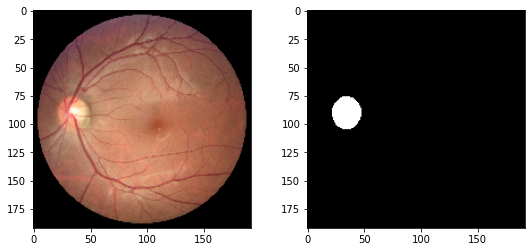

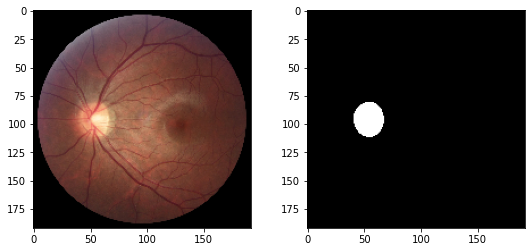

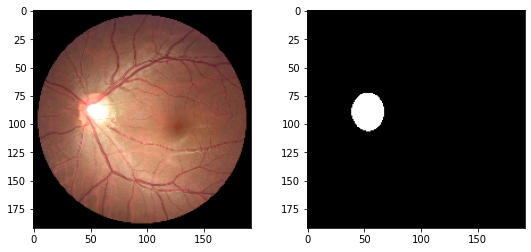

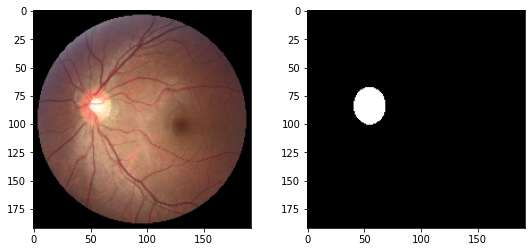

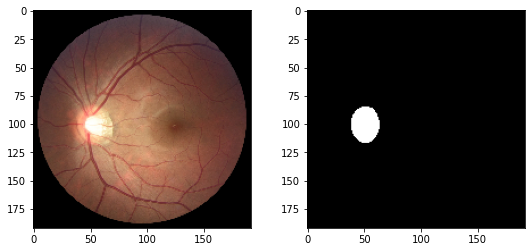

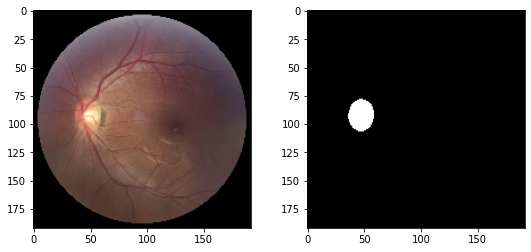

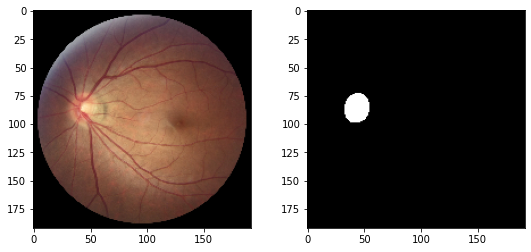

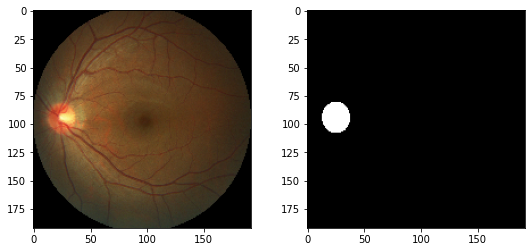

In [ ]:
for i in range(0,720,100):
  fig = plt.figure(figsize=(9, 4))
  ax = plt.subplot(1,2,1)
  plt.imshow(x_train[i,:,:,:])
  ax = plt.subplot(1,2,2)
  plt.imshow(y_train[i,:,:,0] , cmap='gray')
  plt.show()

In [ ]:
def augment(x, y):

  image = tf.cast(x, tf.float32)
  label = tf.cast(y, tf.float32)

  image_zoom = tf.image.crop_to_bounding_box(image,50,5,120,150)
  image_zoom = tf.image.resize(image_zoom , size=[192,192])
  label_zoom = tf.image.crop_to_bounding_box(label,50,5,120,150)
  label_zoom = tf.image.resize(label_zoom , size=[192,192])

  image_zoom_flip = tf.image.flip_left_right(image_zoom)
  label_zoom_flip = tf.image.flip_left_right(label_zoom)
  
  image_zoom_intensity      = tf.image.random_contrast(image_zoom,1.5,3.5)
  image_zoom_flip_intensity = tf.image.random_contrast(image_zoom_flip,1.5,3.5)

  image_intensity      = tf.image.random_contrast(image,1.5,3.5)
  image_intensity_flip = tf.image.flip_left_right(image_intensity)

  image_flip = tf.image.flip_left_right(image)
  label_flip = tf.image.flip_left_right(label)

  image = tf.concat([image, image_flip, image_zoom, image_zoom_flip, image_zoom_intensity, image_zoom_flip_intensity, image_intensity,image_intensity_flip], 0)
  label = tf.concat([label, label_flip, label_zoom, label_zoom_flip, label_zoom          , label_zoom_flip          , label          , label_flip], 0)

  image = np.array(image)
  label = np.array(label)

  image = np.clip(image, 0, 1)
  label[label >= 0.5] = 1.
  label[label < 0.5]  = 0. 

  
  #image = [skimage.exposure.equalize_adapthist(image)]


  image , label = shuffle(image , label)


  return image, label




In [ ]:
x_train , y_train = augment(x_train, y_train)
x_valid , y_valid = augment(x_valid, y_valid)
x_test  , y_test  = augment(x_test, y_test)

In [ ]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)
print(x_valid.shape)
print(y_valid.shape)

(5760, 192, 192, 3)
(5760, 192, 192, 1)
(1920, 192, 192, 3)
(1920, 192, 192, 1)
(1920, 192, 192, 3)
(1920, 192, 192, 1)


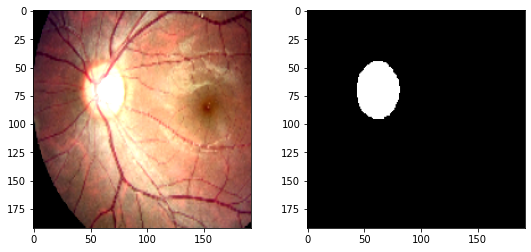

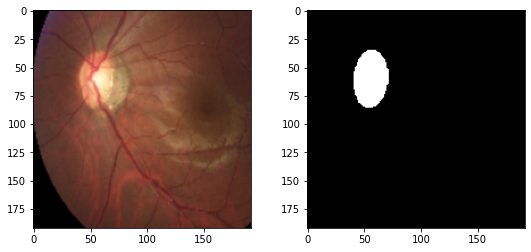

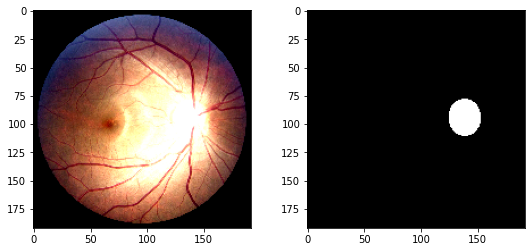

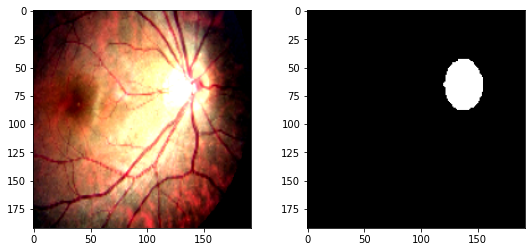

In [ ]:
for i in range(2000,2400,100):
  fig = plt.figure(figsize=(9, 4))
  ax = plt.subplot(1,2,1)
  plt.imshow(x_train[i,:,:,:])
  ax = plt.subplot(1,2,2)
  plt.imshow(y_train[i,:,:,0] , cmap='gray')
  plt.show()

In [ ]:
np.save('/content/drive/MyDrive/Variables/x_train', x_train)
np.save('/content/drive/MyDrive/Variables/y_train', y_train)
np.save('/content/drive/MyDrive/Variables/x_valid', x_valid)
np.save('/content/drive/MyDrive/Variables/y_valid', y_valid)
np.save('/content/drive/MyDrive/Variables/x_test', x_test)
np.save('/content/drive/MyDrive/Variables/y_test', y_test)


In [ ]:
x_train = np.load('/content/drive/MyDrive/Variables/x_train.npy')
y_train = np.load('/content/drive/MyDrive/Variables/y_train.npy')
x_valid = np.load('/content/drive/MyDrive/Variables/x_valid.npy')
y_valid = np.load('/content/drive/MyDrive/Variables/y_valid.npy')
x_test = np.load('/content/drive/MyDrive/Variables/x_test.npy')
y_test = np.load('/content/drive/MyDrive/Variables/y_test.npy')

## **Model**

In [ ]:
def mean_IOU_gpu(X, Y):
    """Computes mean Intersection-over-Union (IOU) for two arrays of binary images.
    Assuming X and Y are of shape (n_images, w, h)."""
    
    #X_fl = K.clip(K.batch_flatten(X), K.epsilon(), 1.)
    #Y_fl = K.clip(K.batch_flatten(Y), K.epsilon(), 1.)
    X_fl = K.clip(K.batch_flatten(X), 0., 1.)
    Y_fl = K.clip(K.batch_flatten(Y), 0., 1.)
    X_fl = K.cast(K.greater(X_fl, 0.5), 'float32')
    Y_fl = K.cast(K.greater(Y_fl, 0.5), 'float32')

    intersection = K.sum(X_fl * Y_fl, axis=1)
    union = K.sum(K.maximum(X_fl, Y_fl), axis=1)
    # if union == 0, it follows that intersection == 0 => score should be 0.
    union = K.switch(K.equal(union, 0), K.ones_like(union), union)
    return K.mean(intersection / K.cast(union, 'float32'))


def mean_IOU_gpu_loss(X, Y):
    return -mean_IOU_gpu(X, Y)

In [ ]:
def dice(y_true, y_pred):
    # Workaround for shape bug. For some reason y_true shape was not being set correctly
    #y_true.set_shape(y_pred.get_shape())

    # Without K.clip, K.sum() behaves differently when compared to np.count_nonzero()
    #y_true_f = K.clip(K.batch_flatten(y_true), K.epsilon(), 1.)
    #y_pred_f = K.clip(K.batch_flatten(y_pred), K.epsilon(), 1.)
    y_true_f = K.clip(K.batch_flatten(y_true), 0., 1.)
    y_pred_f = K.clip(K.batch_flatten(y_pred), 0., 1.)
    #y_pred_f = K.greater(y_pred_f, 0.5)

    intersection = 2 * K.sum(y_true_f * y_pred_f, axis=1)
    union = K.sum(y_true_f * y_true_f, axis=1) + K.sum(y_pred_f * y_pred_f, axis=1)
    return K.mean(intersection / union)


def dice_loss(y_true, y_pred):
    return -dice(y_true, y_pred)


def log_dice_loss(y_true, y_pred):
    return -K.log(dice(y_true, y_pred))


def dice_metric(y_true, y_pred):
    """An exact Dice score for binary tensors."""
    y_true_f = K.cast(K.greater(y_true, 0.5), 'float32')
    y_pred_f = K.cast(K.greater(y_pred, 0.5), 'float32')
    return dice(y_true_f, y_pred_f)

In [ ]:
def unet(pretrained_weights = False ,input_size = (192,192,3)):
    inputs = Input(input_size)
    conv1 = Conv2D(32, kernel_size=3, activation='relu', padding='same')(inputs)
    #conv1 = Dropout(0.3)(conv1)
    conv1 = BatchNormalization()(conv1)
    conv1 = Conv2D(32, kernel_size=3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(pool1)
    #conv2 = Dropout(0.3)(conv2)
    conv2 = BatchNormalization()(conv2)
    conv2 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(pool2)
    #conv3 = Dropout(0.3)(conv3)
    conv3 = BatchNormalization()(conv3)
    conv3 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(pool3)
    #conv4 = Dropout(0.3)(conv4)
    conv4 = BatchNormalization()(conv4)
    conv4 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    conv5 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(pool4)
    #conv5 = Dropout(0.3)(conv5)
    conv5 = BatchNormalization()(conv5)
    conv5 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv5)


    up6 = Concatenate(axis=3)([UpSampling2D(size=(2, 2))(conv5), conv4])
    conv6 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(up6)
    #conv6 = Dropout(0.3)(conv6)
    conv6 = BatchNormalization()(conv6)
    conv6 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv6)

    up7 = Concatenate(axis=3)([UpSampling2D(size=(2, 2))(conv6), conv3])
    conv7 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(up7)
    #conv7 = Dropout(0.3)(conv7)
    conv7 = BatchNormalization()(conv7)
    conv7 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv7)

    up8 = Concatenate(axis=3)([UpSampling2D(size=(2, 2))(conv7), conv2])
    conv8 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(up8)
    #conv8 = Dropout(0.3)(conv8)
    conv8 = BatchNormalization()(conv8)
    conv8 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv8)

    up9 = Concatenate(axis=3)([UpSampling2D(size=(2, 2))(conv8), conv1])
    conv9 = Conv2D(32, kernel_size=3, activation='relu', padding='same')(up9)
    conv9 = Dropout(0.3)(conv9)
    conv9 = BatchNormalization()(conv9)
    conv9 = Conv2D(32, kernel_size=3, activation='relu', padding='same')(conv9)

    conv10 = Conv2D(1, kernel_size=1, activation='sigmoid', padding='same')(conv9)
    #conv10 = Flatten()(conv10)

    model = Model(inputs = inputs, outputs = conv10)

    model.compile(optimizer=SGD(lr=1e-3, momentum=0.95), loss=log_dice_loss,
                  metrics=[mean_IOU_gpu, dice_metric]) 
    

    if(pretrained_weights):
      	model.load_weights(pretrained_weights)

    return model


In [ ]:
my_model = unet()
my_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 192, 192, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 192, 192, 32) 896         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 192, 192, 32) 128         conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 192, 192, 32) 9248        batch_normalization[0][0]        
______________________________________________________________________________________________

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


In [ ]:
arch_name = "U-Net, on REFUGE, SGD , high augm, log_dice loss"
weights_folder = os.path.join(os.path.dirname(os.getcwd()), '/content/drive/MyDrive/Result/models_weights',
                              '{},{}'.format(datetime.now().strftime('%d.%m,%H:%M'), arch_name))
print(weights_folder)

/content/drive/MyDrive/Result/models_weights/11.06,20:07,U-Net, on REFUGE, SGD , high augm, log_dice loss


In [ ]:
def folder(folder_name):
    if not os.path.exists(folder_name):
        os.makedirs(folder_name)
    return folder_name

In [ ]:
filepath_best = os.path.join(folder(weights_folder),'last_checkpoint.hdf5')
best_check = ModelCheckpoint(filepath_best, monitor='val_loss', mode='min', save_best_only=True, 
                                               save_weights_only=False, verbose=0)

erlstop = EarlyStopping(monitor='val_loss',
                              patience=10,
                              verbose=0, mode='min')

history= my_model.fit(x_train,y_train, batch_size=64,epochs=50,steps_per_epoch=90,shuffle=True,
                      validation_data=(x_valid,y_valid), validation_batch_size = 64, validation_steps=30,
                      verbose = 1,
                      callbacks=[CSVLogger(os.path.join(folder(weights_folder), 'training_log.csv')),best_check ])

'''
history= my_model.fit(data_generator(x_train,y_train, train_or_test='train', batch_size=8), 
                      validation_data=next(data_generator(x_valid,y_valid,train_or_test='test',batch_size=800)),
                      epochs=100,steps_per_epoch=100,verbose = 1,
                      callbacks=[CSVLogger(os.path.join(folder(weights_folder), 'training_log.csv')),best_check ])

history= my_model.fit(train_ds, 
                      validation_data=val_ds,
                      epochs=100,verbose = 1,
                      callbacks=[CSVLogger(os.path.join(folder(weights_folder), 'training_log.csv')),best_check,erlstop ])
'''


Epoch 1/50
90/90 [==============================] - 109s 596ms/step - loss: 1.5764 - mean_IOU_gpu: 0.1935 - dice_metric: 0.2628 - val_loss: 2.7528 - val_mean_IOU_gpu: 0.0000e+00 - val_dice_metric: 0.0000e+00
Epoch 2/50
90/90 [==============================] - 52s 583ms/step - loss: 0.2010 - mean_IOU_gpu: 0.6868 - dice_metric: 0.7963 - val_loss: 4.2018 - val_mean_IOU_gpu: 0.0000e+00 - val_dice_metric: 0.0000e+00
Epoch 3/50
90/90 [==============================] - 54s 602ms/step - loss: 0.1001 - mean_IOU_gpu: 0.7964 - dice_metric: 0.8817 - val_loss: 4.2798 - val_mean_IOU_gpu: 0.0000e+00 - val_dice_metric: 0.0000e+00
Epoch 4/50
90/90 [==============================] - 54s 601ms/step - loss: 0.0816 - mean_IOU_gpu: 0.8247 - dice_metric: 0.9007 - val_loss: 2.3647 - val_mean_IOU_gpu: 0.0324 - val_dice_metric: 0.0502
Epoch 5/50
90/90 [==============================] - 53s 592ms/step - loss: 0.0767 - mean_IOU_gpu: 0.8334 - dice_metric: 0.9062 - val_loss: 0.6229 - val_mean_IOU_gpu: 0.3613 - val_

"\nhistory= my_model.fit(data_generator(x_train,y_train, train_or_test='train', batch_size=8), \n                      validation_data=next(data_generator(x_valid,y_valid,train_or_test='test',batch_size=800)),\n                      epochs=100,steps_per_epoch=100,verbose = 1,\n                      callbacks=[CSVLogger(os.path.join(folder(weights_folder), 'training_log.csv')),best_check ])\n\nhistory= my_model.fit(train_ds, \n                      validation_data=val_ds,\n                      epochs=100,verbose = 1,\n                      callbacks=[CSVLogger(os.path.join(folder(weights_folder), 'training_log.csv')),best_check,erlstop ])\n"

In [ ]:
score = my_model.evaluate(x_valid,y_valid,batch_size=64,steps=30)
print(score)

30/30 [==============================] - 4s 146ms/step - loss: 0.0535 - mean_IOU_gpu: 0.8775 - dice_metric: 0.9326
[0.05348289757966995, 0.8775070905685425, 0.9326112270355225]


In [ ]:
score = my_model.evaluate(x_test,y_test,batch_size=64,steps=30)
print(score)

30/30 [==============================] - 4s 145ms/step - loss: 0.0623 - mean_IOU_gpu: 0.8609 - dice_metric: 0.9226
[0.06228480860590935, 0.8609470129013062, 0.9226042628288269]


dict_keys(['loss', 'mean_IOU_gpu', 'dice_metric', 'val_loss', 'val_mean_IOU_gpu', 'val_dice_metric'])


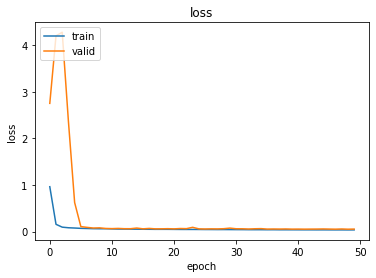

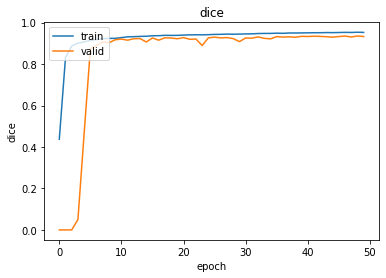

In [ ]:
print(history.history.keys())

#plt.subplot(1,2,1)        
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('loss')
plt.ylabel('loss')  
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='upper left')
plt.show()

#plt.subplot(1,2,2)        
plt.plot(history.history['dice_metric'])
plt.plot(history.history['val_dice_metric'])
plt.title('dice')
plt.ylabel('dice')  
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='upper left')
plt.show()
#plt.plot(history.history['loss'])


In [ ]:
my_model.save('/content/drive/MyDrive/Result/my_model.h5')

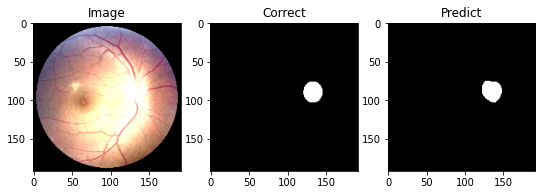

IOU: 0.8205546736717224
Dice: 0.9014337062835693
Image number: 1544


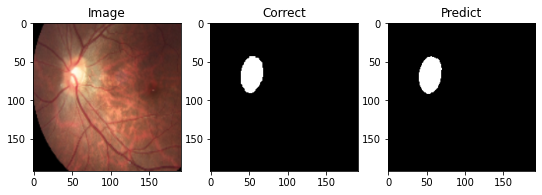

IOU: 0.9288849830627441
Dice: 0.9631315469741821
Image number: 876


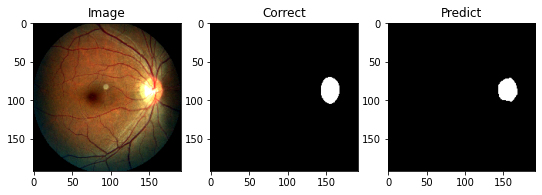

IOU: 0.8565153479576111
Dice: 0.9227129220962524
Image number: 1704


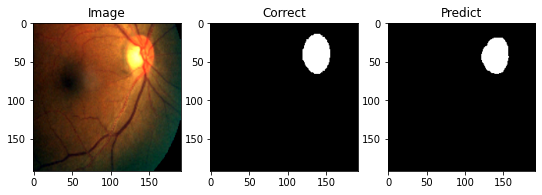

IOU: 0.8465679883956909
Dice: 0.9169096350669861
Image number: 27


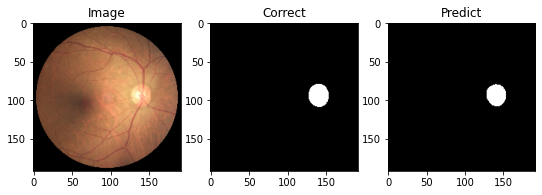

IOU: 0.9066455960273743
Dice: 0.9510373473167419
Image number: 961


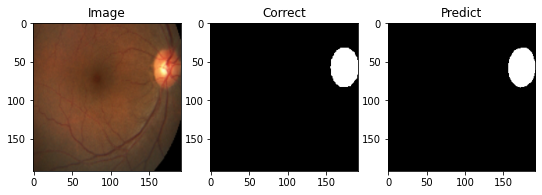

IOU: 0.9463931322097778
Dice: 0.9724583625793457
Image number: 1549


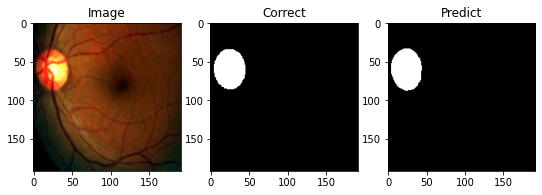

IOU: 0.8980609178543091
Dice: 0.9462930560112
Image number: 1354


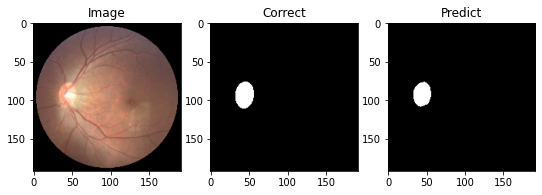

IOU: 0.8645833134651184
Dice: 0.9273743033409119
Image number: 1555


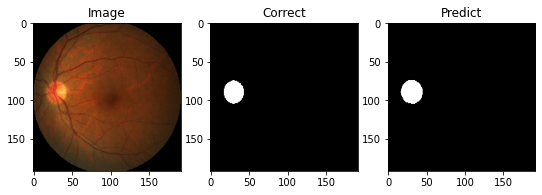

IOU: 0.8955007195472717
Dice: 0.9448698163032532
Image number: 1496


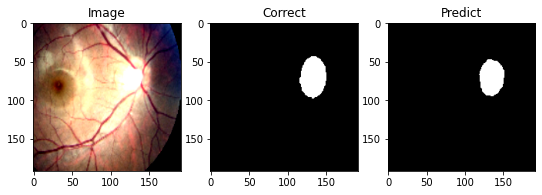

IOU: 0.8292011022567749
Dice: 0.9066265225410461
Image number: 736


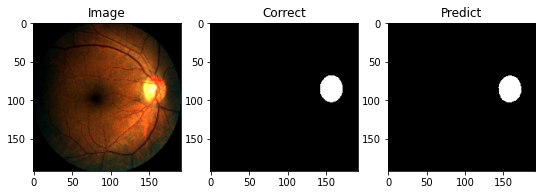

IOU: 0.9287410974502563
Dice: 0.9630541801452637
Image number: 1264


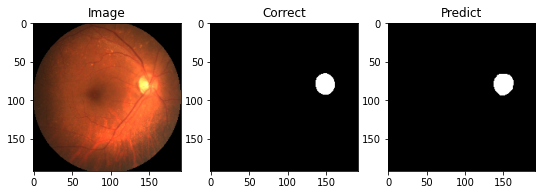

IOU: 0.9255499243736267
Dice: 0.9613356590270996
Image number: 1560


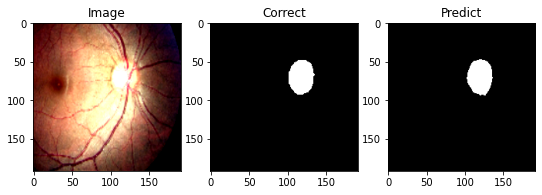

IOU: 0.9061257243156433
Dice: 0.9507512450218201
Image number: 1634


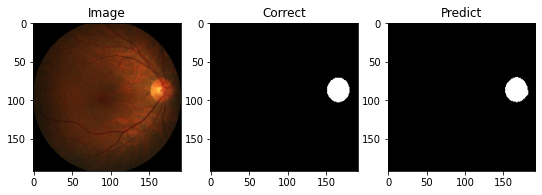

IOU: 0.9651941061019897
Dice: 0.9822888374328613
Image number: 234


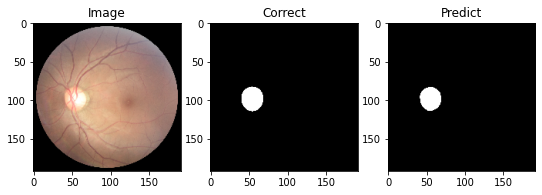

IOU: 0.9416666626930237
Dice: 0.9699570536613464
Image number: 958


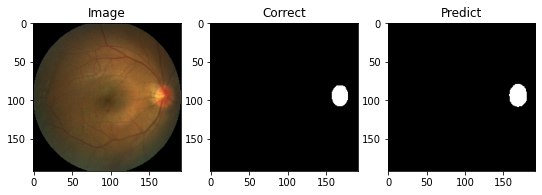

IOU: 0.8623853325843811
Dice: 0.9261083602905273
Image number: 692


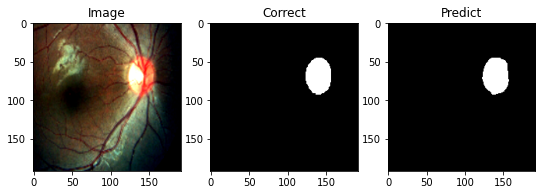

IOU: 0.9188988208770752
Dice: 0.957735538482666
Image number: 455


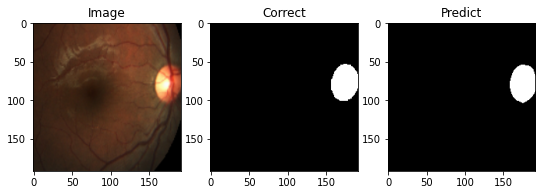

IOU: 0.924297034740448
Dice: 0.9606594443321228
Image number: 1119


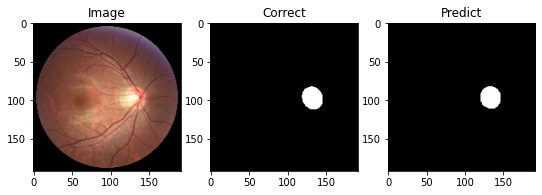

IOU: 0.9203675389289856
Dice: 0.9585326910018921
Image number: 1048


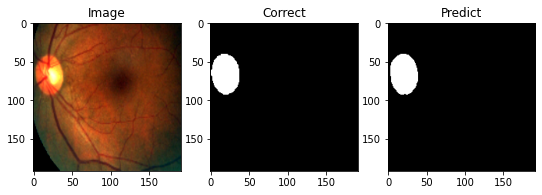

IOU: 0.9463258981704712
Dice: 0.9724228382110596
Image number: 129


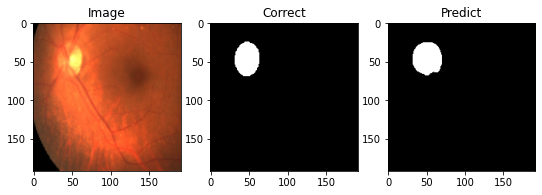

IOU: 0.7947406768798828
Dice: 0.8856328725814819
Image number: 827


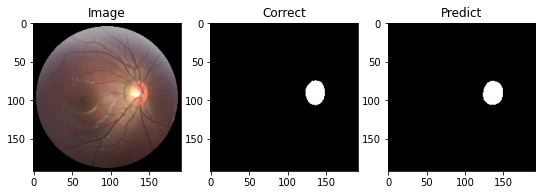

IOU: 0.9413533806800842
Dice: 0.9697908759117126
Image number: 1499


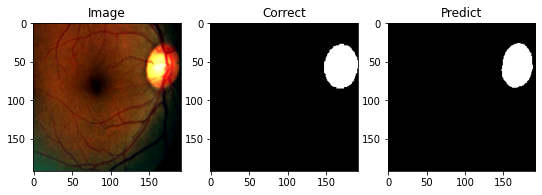

IOU: 0.8519061803817749
Dice: 0.9200316667556763
Image number: 1584


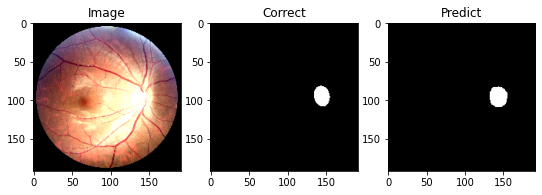

IOU: 0.7731568813323975
Dice: 0.8720682263374329
Image number: 1203


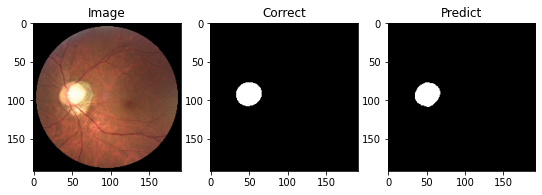

IOU: 0.9268584847450256
Dice: 0.9620410799980164
Image number: 13


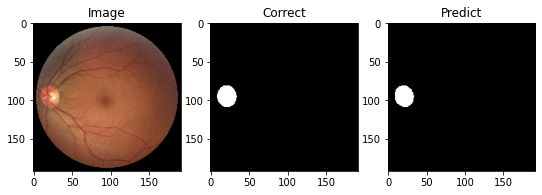

IOU: 0.9142367243766785
Dice: 0.9551971554756165
Image number: 239


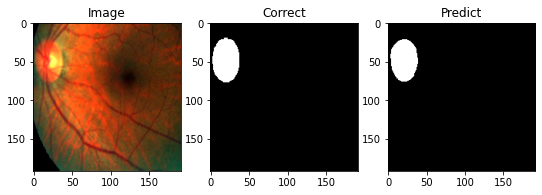

IOU: 0.9351682066917419
Dice: 0.966498076915741
Image number: 1828


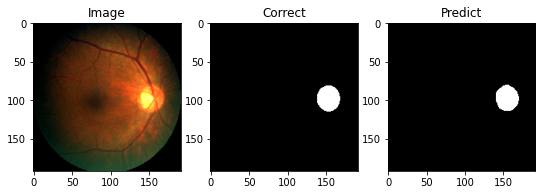

IOU: 0.9241877198219299
Dice: 0.9606003761291504
Image number: 704


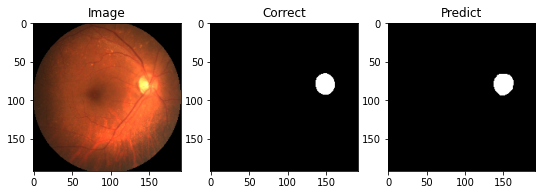

IOU: 0.9255499243736267
Dice: 0.9613356590270996
Image number: 1560


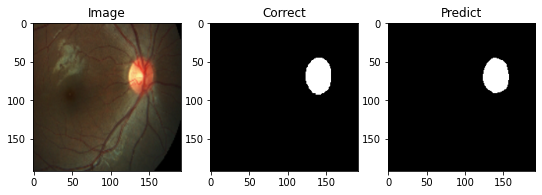

IOU: 0.9175019264221191
Dice: 0.9569762945175171
Image number: 1070


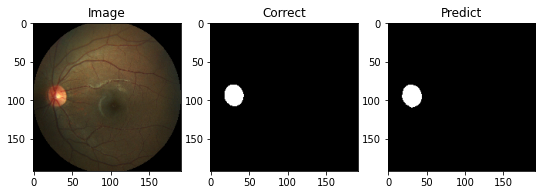

IOU: 0.9338983297348022
Dice: 0.9658194780349731
Image number: 1576


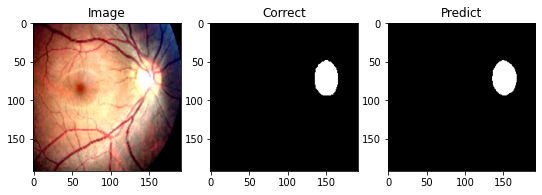

IOU: 0.9444444179534912
Dice: 0.9714285731315613
Image number: 1839


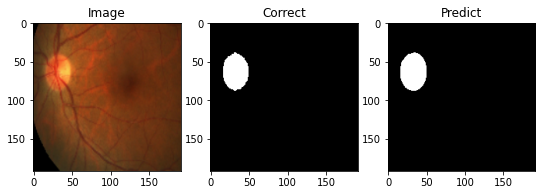

IOU: 0.9251101613044739
Dice: 0.9610983729362488
Image number: 77


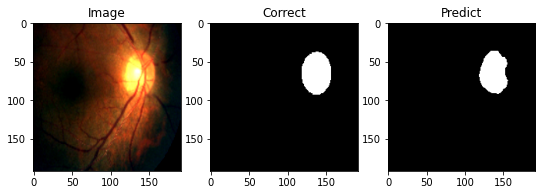

IOU: 0.8897228837013245
Dice: 0.9416437745094299
Image number: 792


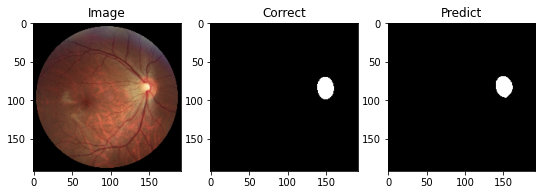

IOU: 0.8171641826629639
Dice: 0.8993839621543884
Image number: 842


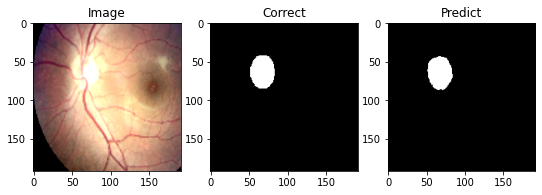

IOU: 0.8887000679969788
Dice: 0.9410706162452698
Image number: 1535


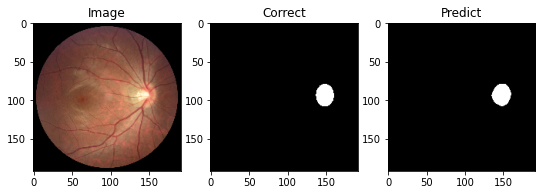

IOU: 0.8341708779335022
Dice: 0.9095890522003174
Image number: 994


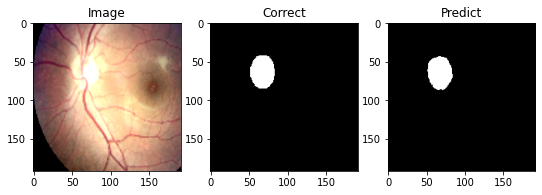

IOU: 0.8887000679969788
Dice: 0.9410706162452698
Image number: 1535


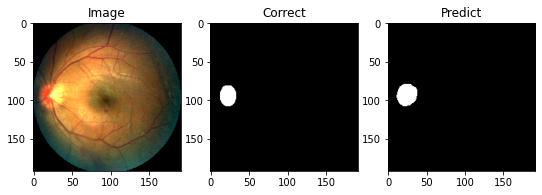

IOU: 0.7597402334213257
Dice: 0.8634686470031738
Image number: 48


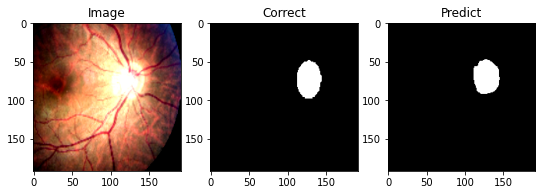

IOU: 0.8189911246299744
Dice: 0.9004893898963928
Image number: 255


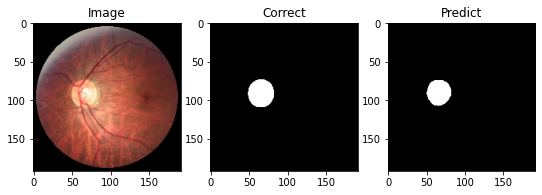

IOU: 0.8516260385513306
Dice: 0.9198682904243469
Image number: 1097


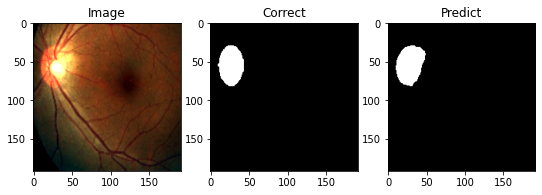

IOU: 0.8500651717185974
Dice: 0.918956995010376
Image number: 74


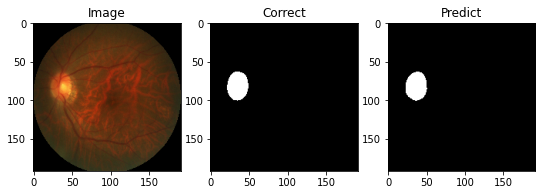

IOU: 0.9142525792121887
Dice: 0.9552057981491089
Image number: 1568


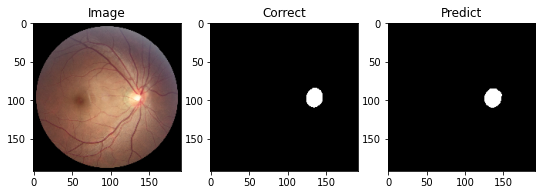

IOU: 0.9041394591331482
Dice: 0.9496567249298096
Image number: 1347


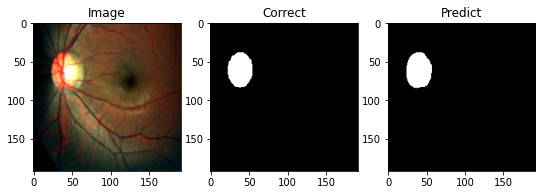

IOU: 0.9073634147644043
Dice: 0.9514321088790894
Image number: 1854


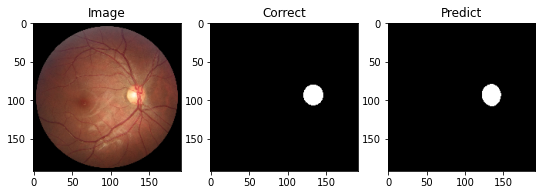

IOU: 0.9321739077568054
Dice: 0.9648965001106262
Image number: 1066


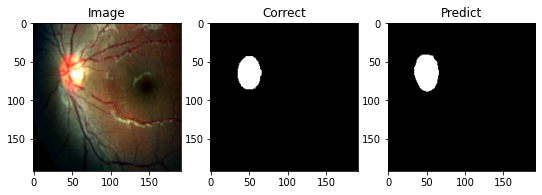

IOU: 0.8589109182357788
Dice: 0.9241011738777161
Image number: 1029


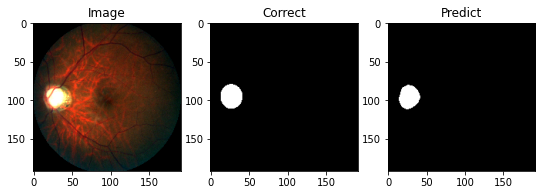

IOU: 0.8678473830223083
Dice: 0.9292487502098083
Image number: 1515


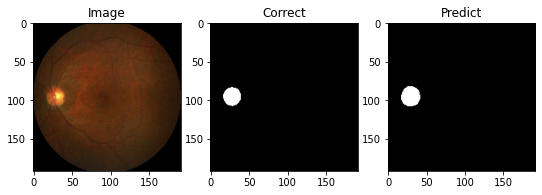

IOU: 0.8423076868057251
Dice: 0.9144049882888794
Image number: 1084


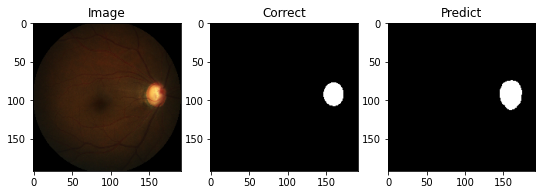

IOU: 0.730195164680481
Dice: 0.8440610766410828
Image number: 1850


In [ ]:
img_num = np.random.randint(1920, size=(1 , 50))
X,Y = x_test , y_test
for i in img_num[0]:
  num=i
  img = X[num,:,:,:]
  mask = Y[num,:,:,:]
  mask = mask.astype('float32')
  pred=[]
  pred = my_model.predict(np.expand_dims(img, 0))

  msk=[]
  msk  = pred.squeeze()
  msk[msk >= 0.5] = 1.0 
  msk[msk < 0.5] = 0.0 
  
  fig = plt.figure(figsize=(9, 4))
  ax=plt.subplot(1,3,1)
  plt.imshow(img.squeeze())
  ax.set_title('Image')
  ax=plt.subplot(1,3,2)
  plt.imshow(mask.squeeze(), cmap='gray')
  ax.set_title('Correct')
  ax=plt.subplot(1,3,3)
  plt.imshow(msk , cmap='gray')
  ax.set_title('Predict')
  plt.show()


  cur_iou  = K.eval(mean_IOU_gpu(msk[None,None,...], mask[None,None,...]))
  cur_dice = K.eval(dice(msk[None, None, ...], mask[None, None, ...]))
  print('IOU: {}\nDice: {}'.format(cur_iou, cur_dice))  
  print("Image number:" , num)

# **Load Model**

In [ ]:
weights_folder = '/content/drive/MyDrive/Result/models_weights/11.06,20:07,U-Net, on REFUGE, SGD , high augm, log_dice loss'
load_model = True   # lock
if not load_model:
    print('load_model == False')
else:
    
    model_folder = os.path.join(os.path.dirname(os.getcwd()),weights_folder )

    model_path = max(glob.glob(os.path.join(model_folder, '*.hdf5')), key=os.path.getctime)
    if load_model and not os.path.exists(model_path):
        raise Exception('`model_path` does not exist')
    print('Loading weights from', model_path)

    if load_model:
        #with open(model_path + ' arch.json') as arch_file:
        #    json_string = arch_file.read()
        #new_model = model_from_json(json_string)
        my_model.load_weights(model_path)

Loading weights from /content/drive/MyDrive/Result/models_weights/11.06,20:07,U-Net, on REFUGE, SGD , high augm, log_dice loss/last_checkpoint.hdf5


In [ ]:
 import pandas as pd
    
log_path = os.path.join(model_folder, 'training_log.csv')
if os.path.exists(log_path):
    log = pd.read_csv(log_path)
    if log['epoch'].dtype != 'int64':
        log = log.loc[log.epoch != 'epoch']
    print('\nmax val mean IOU: {}, at row:'.format(log['val_mean_IOU_gpu'].max()))
    print(log.loc[log['val_mean_IOU_gpu'].idxmax()])
    if 'val_dice_metric' in log.columns:
        print('\n' + 'max val dice_metric: {}, at row:'.format(log['val_dice_metric'].max()))
        print(log.loc[log['val_dice_metric'].idxmax()])
    if 'val_dice' in log.columns:
        print('\n' + 'max val dice: {}, at row:'.format(log['val_dice'].max()))
        print(log.loc[log['val_dice'].idxmax()])

    print('\nmin val mean IOU: {}, at row:'.format(log['val_mean_IOU_gpu'].min()))
    print(log.loc[log['val_mean_IOU_gpu'].idxmin()])
    if 'val_dice_metric' in log.columns:
        print('\n' + 'min val dice_metric: {}, at row:'.format(log['val_dice_metric'].min()))
        print(log.loc[log['val_dice_metric'].idxmin()])
    if 'val_dice' in log.columns:
        print('\n' + 'min val dice: {}, at row:'.format(log['val_dice'].min()))
        print(log.loc[log['val_dice'].idxmin()])     


max val mean IOU: 0.8816422820091248, at row:
epoch               48.000000
dice_metric          0.953347
loss                 0.035490
mean_IOU_gpu         0.911484
val_dice_metric      0.935343
val_loss             0.050998
val_mean_IOU_gpu     0.881642
Name: 48, dtype: float64

max val dice_metric: 0.9353434443473816, at row:
epoch               48.000000
dice_metric          0.953347
loss                 0.035490
mean_IOU_gpu         0.911484
val_dice_metric      0.935343
val_loss             0.050998
val_mean_IOU_gpu     0.881642
Name: 48, dtype: float64

min val mean IOU: 0.0, at row:
epoch               0.000000
dice_metric         0.437498
loss                0.963161
mean_IOU_gpu        0.345578
val_dice_metric     0.000000
val_loss            2.752834
val_mean_IOU_gpu    0.000000
Name: 0, dtype: float64

min val dice_metric: 0.0, at row:
epoch               0.000000
dice_metric         0.437498
loss                0.963161
mean_IOU_gpu        0.345578
val_dice_metric     0.0

In [ ]:
score = my_model.evaluate(x_test,y_test,batch_size=64,steps=30)
print(score)

30/30 [==============================] - 65s 359ms/step - loss: 0.0531 - mean_IOU_gpu: 0.8769 - dice_metric: 0.9329
[0.05185677483677864, 0.8794625997543335, 0.9344097971916199]


# **Load New Test Dataset**



In [ ]:
!unzip '/content/drive/MyDrive/Dr.Kafieh_fundus_data/fundus photos.with documents.zip'

In [ ]:
!unzip '/content/drive/MyDrive/Dr.Kafieh_fundus_data/fundus photos.without documents.zip'

In [ ]:
!unzip '/content/drive/MyDrive/Dr.Kafieh_fundus_data/glaucoma.89-91_without subfolder.zip'

In [ ]:
!unzip '/content/drive/MyDrive/Dr.Kafieh_fundus_data/normal fundus_without subfolder.zip'

In [ ]:
def load_data(path):
    m=192
    n=192
    all_images = sorted(os.listdir(f'{path}'))
    num=len(all_images)
    x = np.empty(shape=(num,m,n,3), dtype=np.float32)
    i=0
    for f in all_images:
        raw = plt.imread(f'{path}/{f}')
        raw = cv2.resize(raw , (m,n))
        raw = raw / np.max(raw)
        raw = [skimage.exposure.equalize_adapthist(raw)]
        raw = np.array(raw)
        x[i,:,:,:] = raw
        i = i +1
    return x , all_images

In [ ]:
#x_test_new , name = load_data("/content/fundus photos.with documents")
#x_test_new , name = load_data("/content/fundus photos.without documents")
#x_test_new , name = load_data("/content/glaucoma.89-91_without subfolder")
#x_test_new , name = load_data("/content/normal fundus_without subfolder")


In [ ]:
from skimage import data
from skimage import exposure
from skimage.exposure import match_histograms


reference = x_train[,:,:,:]
image = x_test_new[300,:,:,:]
matched = match_histograms(image, reference, multichannel=True)

fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(8, 3),
                                    sharex=True, sharey=True)
for aa in (ax1, ax2, ax3):
    aa.set_axis_off()

ax1.imshow(image)
ax1.set_title('Source')
ax2.imshow(reference)
ax2.set_title('Reference')
ax3.imshow(matched)
ax3.set_title('Matched')

plt.tight_layout()
plt.show()

In [ ]:
weights_folder = '/content/drive/MyDrive/Result/models_weights/11.06,20:07,U-Net, on REFUGE, SGD , high augm, log_dice loss'

folder_name1 = folder(os.path.join(os.path.dirname(os.getcwd()), weights_folder ,'fundus photos.with documents mask'))
folder_name2 = folder(os.path.join(os.path.dirname(os.getcwd()), weights_folder ,'fundus photos.without documents mask'))
folder_name3 = folder(os.path.join(os.path.dirname(os.getcwd()), weights_folder ,'glaucoma.89-91_without subfolder mask'))
folder_name4 = folder(os.path.join(os.path.dirname(os.getcwd()), weights_folder ,'normal fundus_without subfolder mask'))

In [ ]:
import numpy as np
import cv2
from shapely.geometry import Polygon
from skimage.morphology import skeletonize, medial_axis
from scipy.ndimage.morphology import distance_transform_edt
import matplotlib.pyplot as plt

def get_center_of_mass(mask):
    M = cv2.moments(mask)
    if M["m00"] !=0:
      cx = int(M["m10"] / M["m00"])
      cy = int(M["m01"] / M["m00"])
    else:
      cx=None
      cy=None
    return cx, cy

def get_skeleton_center_of_mass(mask):

    skel = medial_axis(mask).astype(np.uint8) #<- medial_axis wants binary masks with value 0 and 1
    skel_cnt,_ = cv2.findContours(skel,1,2)
    skel_cnt = skel_cnt[0]
    M = cv2.moments(skel_cnt) 
    if(M["m00"]==0): # this is a line
        cx = int(np.mean(skel_cnt[...,0]))
        cy = int(np.mean(skel_cnt[...,1]))
    else:
        cx = int(M['m10']/M['m00'])
        cy = int(M['m01']/M['m00'])
    return cx, cy

def get_furthest_point_from_edge(mask):
    d = distance_transform_edt(mask)
    cy, cx = np.unravel_index(d.argmax(), d.shape)
    return cx, cy

In [ ]:
markers = ['x', '+', "*"]
colors = ['r','b','g']
functions = [get_center_of_mass, get_skeleton_center_of_mass, get_furthest_point_from_edge]
msk = mask[25,:,:]

plt.figure(figsize=(4,9))
plt.imshow(msk, cmap='gray')
for c, m, f in zip(colors, markers, functions):
  l = f.__name__
  cx, cy = f(msk)
  plt.scatter(cx, cy, c=c, s=100, label=l, marker=m)

plt.tight_layout()    
plt.legend(loc=3)
plt.show()

In [ ]:
from skimage import data
from skimage import exposure
from skimage.exposure import match_histograms

mask= np.empty(shape=(len(x_test_new),192,192), dtype=np.float32)
position = np.empty(shape=(len(x_test_new),2), dtype=np.uint8)

eference = x_train[1,:,:,:]

for i in range(0,len(x_test_new)):
  num=i
  img = x_test_new[num,:,:,:]
  #matched = match_histograms(img, reference, multichannel=True)
  pred=[]
  #pred = my_model.predict(np.expand_dims(matched, 0))
  pred = my_model.predict(np.expand_dims(img, 0))
  msk=[]
  msk  = pred.squeeze()
  msk[msk >= 0.5] = 1 
  msk[msk < 0.5] = 0 

  mask[i,:,:]= msk

  cX , cY = get_furthest_point_from_edge(mask[i,:,:])  

  position[i,:] = [cX , cY]

  f , axarr = plt.subplots(1,2)
  axarr[0].imshow(img )
  axarr[0].scatter(cX,cY , c='red',s=200 , marker='+')
  axarr[0].axis('off')
  axarr[1].imshow(pred.squeeze(), cmap='gray')
  axarr[1].axis('off')
  print("Image number:" , i)
  #f.savefig(f'{folder_name1}/{name[i]}')
  #f.savefig(f'{folder_name2}/{name[i]}')
  #f.savefig(f'{folder_name3}/{name[i]}')
  #f.savefig(f'{folder_name4}/{name[i]}')
  plt.show()


In [ ]:
position1 = position
mask1 = mask

In [ ]:
position2 = position
mask2 = mask

In [ ]:
position3 = position
mask3 = mask

In [ ]:
position4 = position
mask4 = mask

In [ ]:
np.save('/content/drive/MyDrive/Variables/position1', position1)
np.save('/content/drive/MyDrive/Variables/position2', position2)
np.save('/content/drive/MyDrive/Variables/position3', position3)
np.save('/content/drive/MyDrive/Variables/position4', position4)

np.save('/content/drive/MyDrive/Variables/mask1', mask1)
np.save('/content/drive/MyDrive/Variables/mask2', mask2)
np.save('/content/drive/MyDrive/Variables/mask3', mask3)
np.save('/content/drive/MyDrive/Variables/mask4', mask4)

np.save('/content/drive/MyDrive/Variables/x1', x1)
np.save('/content/drive/MyDrive/Variables/x2', x2)
np.save('/content/drive/MyDrive/Variables/x3', x3)
np.save('/content/drive/MyDrive/Variables/x4', x4)

np.save('/content/drive/MyDrive/Variables/name1', name1)
np.save('/content/drive/MyDrive/Variables/name2', name2)
np.save('/content/drive/MyDrive/Variables/name3', name3)
np.save('/content/drive/MyDrive/Variables/name4', name4)

In [ ]:
indx1 = [187,192,247,343]
indx2 = [95]
indx3 = [81,83,88,89,140,142,143,178]
indx4 = [8,172,173,213,259,330,331,332,333,335,488,489,490,491,525,526]

In [ ]:
print(position1.shape)
print(position2.shape)
print(position3.shape)
print(position4.shape)

(380, 2)
(118, 2)
(271, 2)
(556, 2)


In [ ]:
position1[indx1,:] = 0
position2[indx2,:] = 0
position3[indx3,:] = 0
position4[indx4,:] = 0

In [ ]:
def circle(position , mask, r):
  new_mask = np.empty(mask.shape , dtype ="float32")
  for i in range(0,len(mask)):
    cir = np.zeros(mask.shape[1:], dtype="float32")
    if position[i,:][0] != 0 and position[i,:][1] != 0:
      cv2.circle(cir, (position[i,0], position[i,1]),r,1, -1)
    new_mask[i,:] = mask[i,:]* cir
    
    f , axarr = plt.subplots(1,3)
    axarr[0].imshow(cir , cmap='gray')
    axarr[1].imshow(mask[i,:] , cmap='gray')
    axarr[2].imshow(new_mask[i,:] , cmap='gray')
    plt.show()

  return new_mask


In [ ]:
new_mask1 = circle(position1 , mask1 , 40)

In [ ]:
new_mask2 = circle(position2 , mask2 , 33)

In [ ]:
new_mask3 = circle(position3 , mask3 , 34)

In [ ]:
new_mask4 = circle(position4 , mask4 , 34)

In [ ]:
np.save('/content/drive/MyDrive/Variables/new_mask1', new_mask1)
np.save('/content/drive/MyDrive/Variables/new_mask2', new_mask2)
np.save('/content/drive/MyDrive/Variables/new_mask3', new_mask3)
np.save('/content/drive/MyDrive/Variables/new_mask4', new_mask4)

In [ ]:
for i in range(0,len(x1)):
  f , axarr = plt.subplots(1,2)
  print("Image number:" , i)
  axarr[0].imshow(x1[i,:,:,:])
  axarr[0].scatter(position1[i,0] , position1[i,1] , c='blue',s=200 , marker='+')
  axarr[0].axis('off')
  axarr[1].imshow(new_mask1[i,:,:], cmap='gray')
  axarr[1].axis('off')
  f.savefig(f'{folder_name1}/{name1[i]}')
  plt.show()

In [ ]:
for i in range(0,len(x2)):
  f , axarr = plt.subplots(1,2)
  print("Image number:" , i)
  axarr[0].imshow(x2[i,:,:,:])
  axarr[0].scatter(position2[i,0] , position2[i,1] , c='blue',s=200 , marker='+')
  axarr[0].axis('off')
  axarr[1].imshow(new_mask2[i,:,:], cmap='gray')
  axarr[1].axis('off')
  f.savefig(f'{folder_name2}/{name2[i]}')
  plt.show()

In [ ]:
for i in range(0,len(x3)):
  f , axarr = plt.subplots(1,2)
  print("Image number:" , i)
  axarr[0].imshow(x3[i,:,:,:])
  axarr[0].scatter(position3[i,0] , position3[i,1] , c='blue',s=200 , marker='+')
  axarr[0].axis('off')
  axarr[1].imshow(new_mask3[i,:,:], cmap='gray')
  axarr[1].axis('off')
  f.savefig(f'{folder_name3}/{name3[i]}')
  plt.show()

In [ ]:
for i in range(0,len(x4)):
  f , axarr = plt.subplots(1,2)
  print("Image number:" , i)
  axarr[0].imshow(x4[i,:,:,:])
  axarr[0].scatter(position4[i,0] , position4[i,1] , c='blue',s=200 , marker='+')
  axarr[0].axis('off')
  axarr[1].imshow(new_mask4[i,:,:], cmap='gray')
  axarr[1].axis('off')
  f.savefig(f'{folder_name4}/{name4[i]}')
  plt.show()

# **Draw border**

In [ ]:
position1 = np.load('/content/drive/MyDrive/Variables/position1.npy')
position2 = np.load('/content/drive/MyDrive/Variables/position2.npy')
position3 = np.load('/content/drive/MyDrive/Variables/position3.npy')
position4 = np.load('/content/drive/MyDrive/Variables/position4.npy')

mask1 = np.load('/content/drive/MyDrive/Variables/mask1.npy')
mask2 = np.load('/content/drive/MyDrive/Variables/mask2.npy')
mask3 = np.load('/content/drive/MyDrive/Variables/mask3.npy')
mask4 = np.load('/content/drive/MyDrive/Variables/mask4.npy')

x1 = np.load('/content/drive/MyDrive/Variables/x1.npy')
x2 = np.load('/content/drive/MyDrive/Variables/x2.npy')
x3 = np.load('/content/drive/MyDrive/Variables/x3.npy')
x4 = np.load('/content/drive/MyDrive/Variables/x4.npy')

name1 = np.load('/content/drive/MyDrive/Variables/name1.npy')
name2 = np.load('/content/drive/MyDrive/Variables/name2.npy')
name3 = np.load('/content/drive/MyDrive/Variables/name3.npy')
name4 = np.load('/content/drive/MyDrive/Variables/name4.npy')

new_mask1 = np.load('/content/drive/MyDrive/Variables/new_mask1.npy')
new_mask2 = np.load('/content/drive/MyDrive/Variables/new_mask2.npy')
new_mask3 = np.load('/content/drive/MyDrive/Variables/new_mask3.npy')
new_mask4 = np.load('/content/drive/MyDrive/Variables/new_mask4.npy')

In [ ]:
indx1 = [187,192,247,343]
h=[]
for i in range(0,np.shape(new_mask1)[0]):
  if i not in indx1:
    a = np.min(np.where(new_mask1[i,:,:] == 1.0)[0])
    b = np.max(np.where(new_mask1[i,:,:] == 1.0)[0])
    h.append(b-a)

h1 = np.round(np.sum(h)/np.size(h))

indx2 = [95]
h=[]
for i in range(0,np.shape(new_mask2)[0]):
  if i not in indx2:
    a = np.min(np.where(new_mask2[i,:,:] == 1.0)[0])
    b = np.max(np.where(new_mask2[i,:,:] == 1.0)[0])
    h.append(b-a)

h2 = np.round(np.sum(h)/np.size(h))

indx3 = [81,83,88,89,140,142,143,178]
h=[]
for i in range(0,np.shape(new_mask3)[0]):
  if i not in indx3:
    a = np.min(np.where(new_mask3[i,:,:] == 1.0)[0])
    b = np.max(np.where(new_mask3[i,:,:] == 1.0)[0])
    h.append(b-a)

h3 = np.round(np.sum(h)/np.size(h))


indx4 = [8,172,173,213,259,330,331,332,333,335,488,489,490,491,525,526]
h=[]
for i in range(0,np.shape(new_mask4)[0]):
  if i not in indx4:
    a = np.min(np.where(new_mask4[i,:,:] == 1.0)[0])
    b = np.max(np.where(new_mask4[i,:,:] == 1.0)[0])
    h.append(b-a)

h4 = np.round(np.sum(h)/np.size(h))

In [ ]:
H = (h1+h2+h3+h4)/4

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


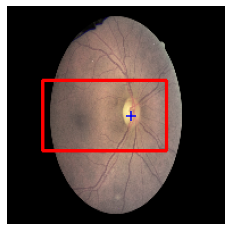

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


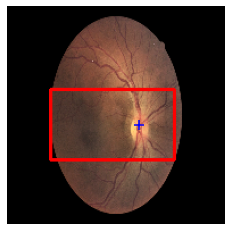

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


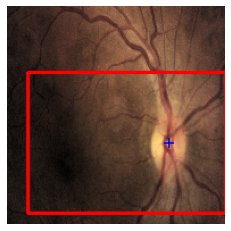

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


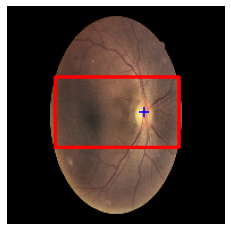

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


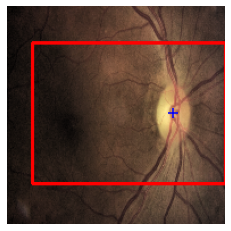

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


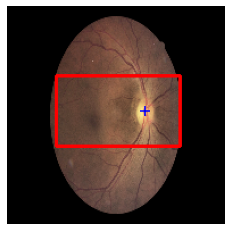

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


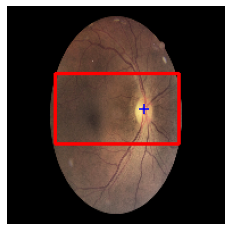

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


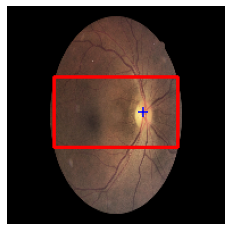

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


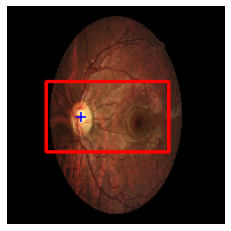

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


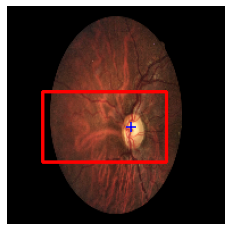

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


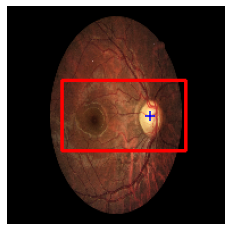

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


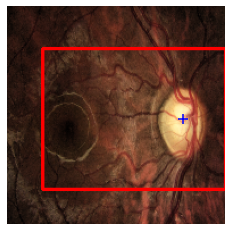

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


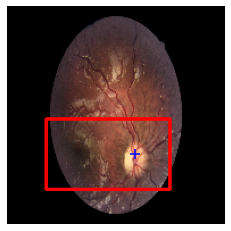

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


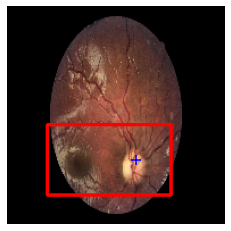

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


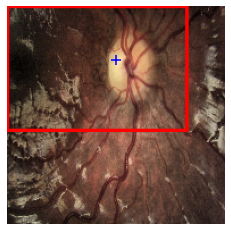

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


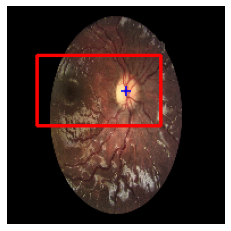

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


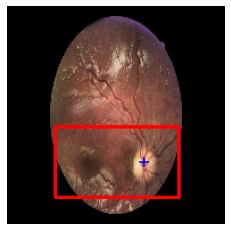

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


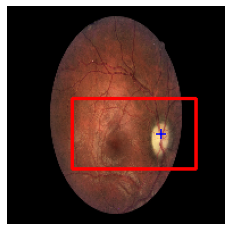

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


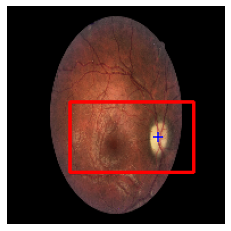

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


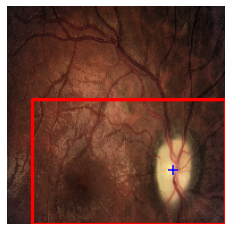

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


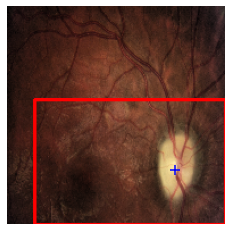

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


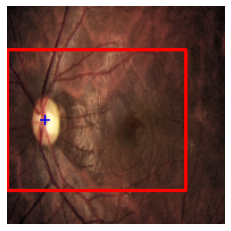

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


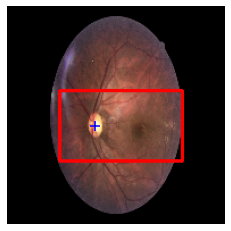

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


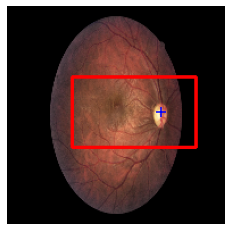

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


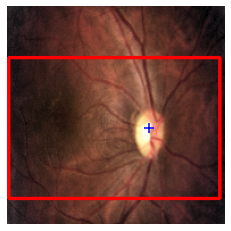

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


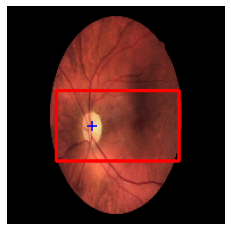

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


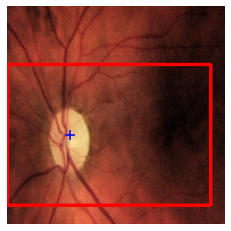

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


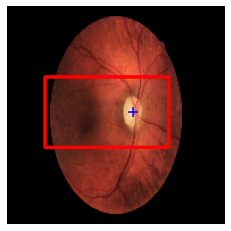

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


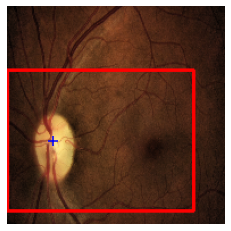

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


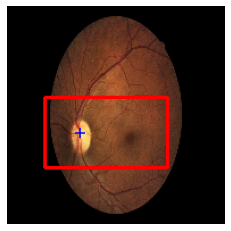

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


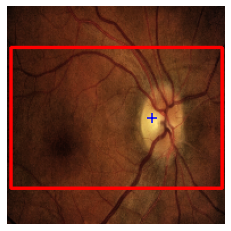

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


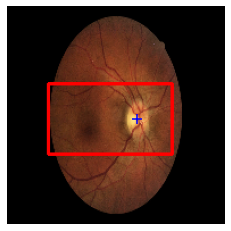

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


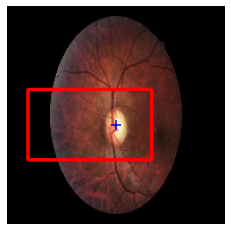

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


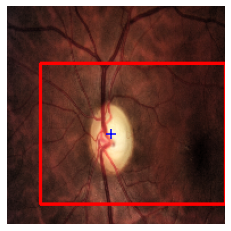

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


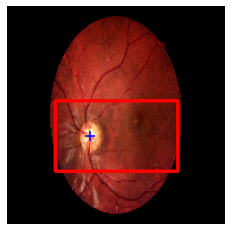

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


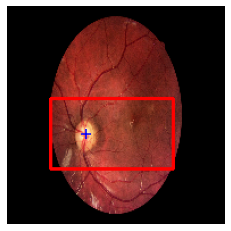

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


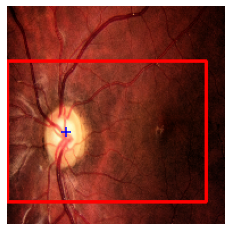

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


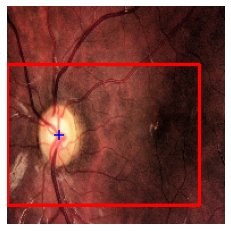

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


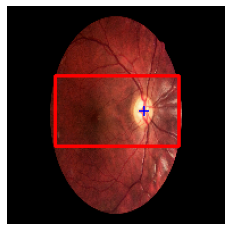

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


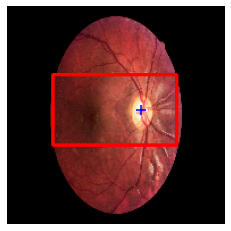

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


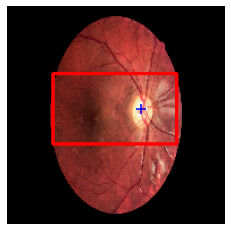

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


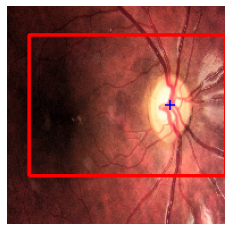

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


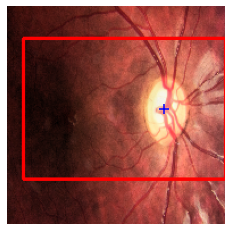

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


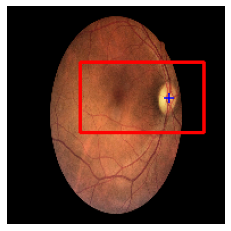

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


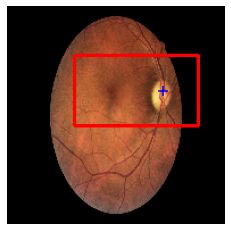

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


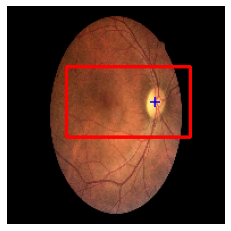

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


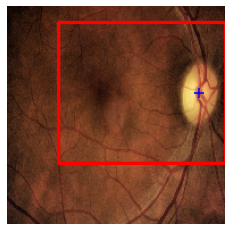

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


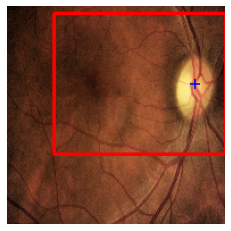

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


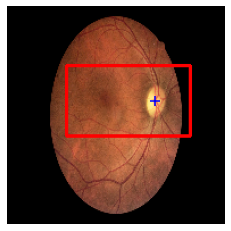

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


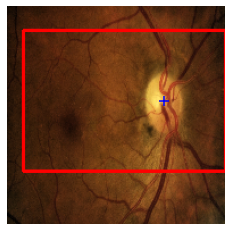

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


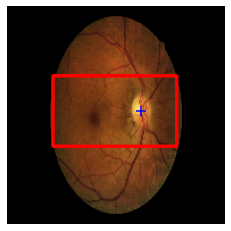

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


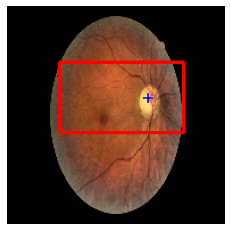

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


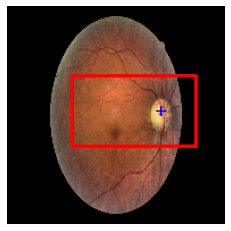

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


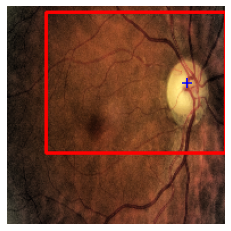

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


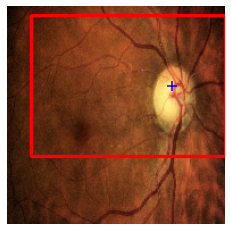

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


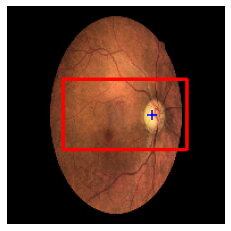

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


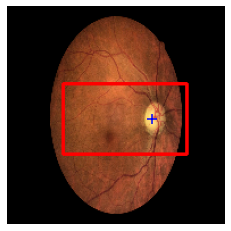

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


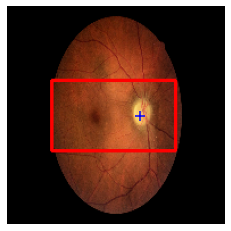

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


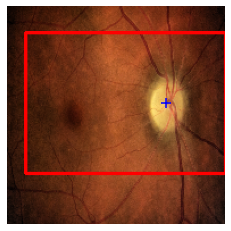

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


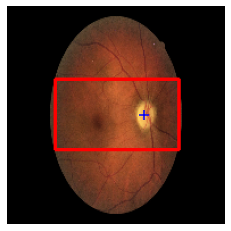

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


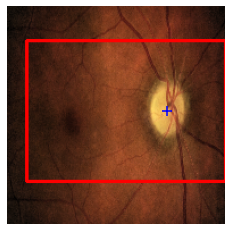

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


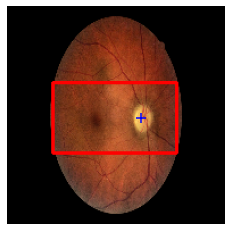

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


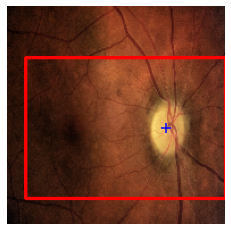

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


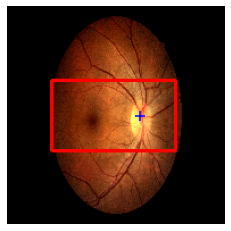

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


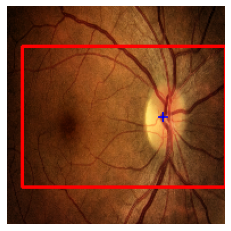

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


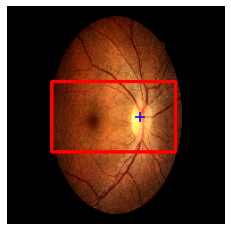

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


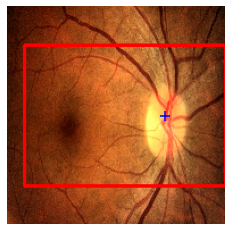

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


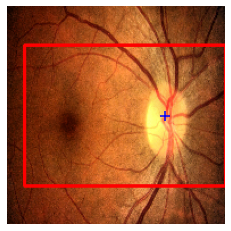

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


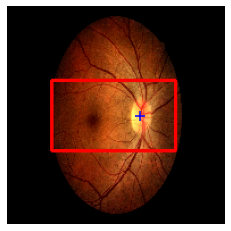

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


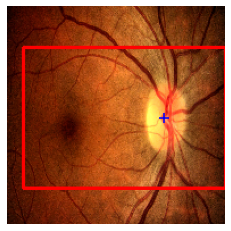

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


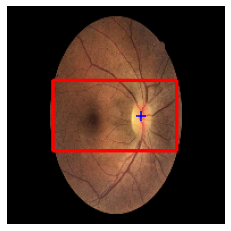

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


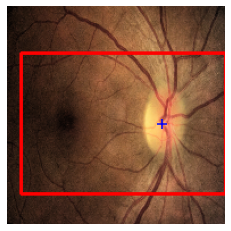

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


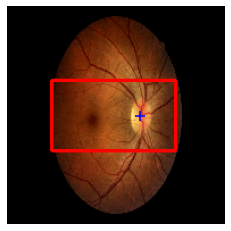

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


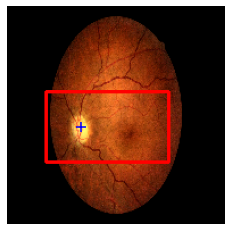

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


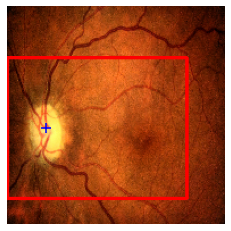

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


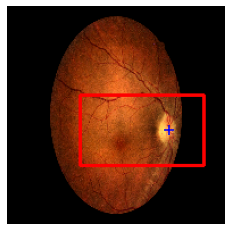

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


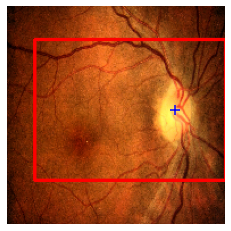

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


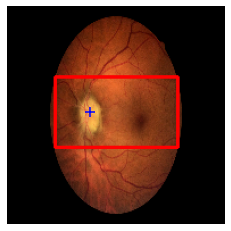

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


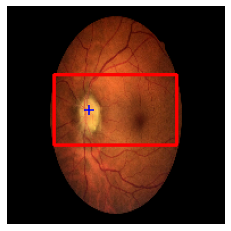

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


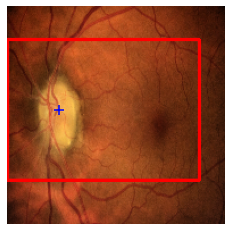

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


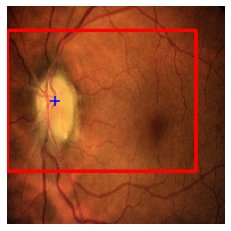

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


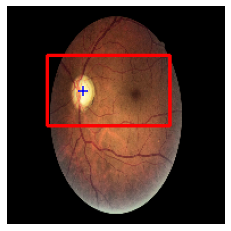

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


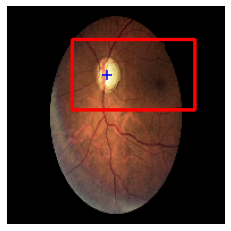

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


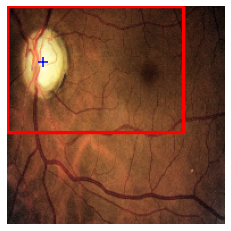

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


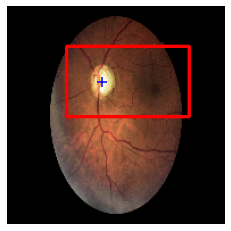

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


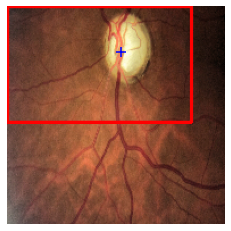

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


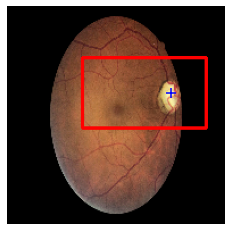

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


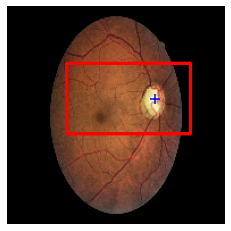

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


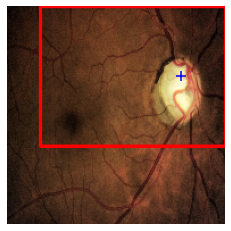

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


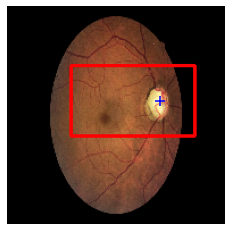

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


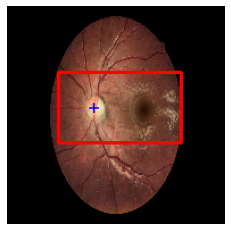

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


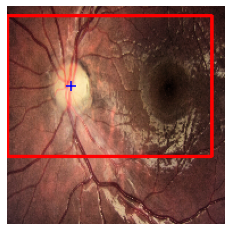

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


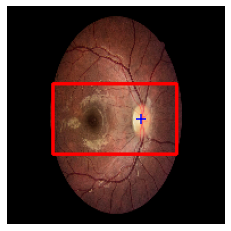

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


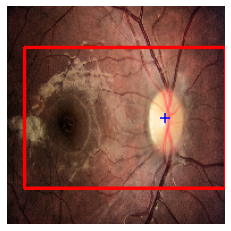

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


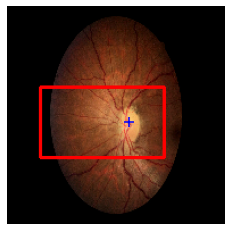

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


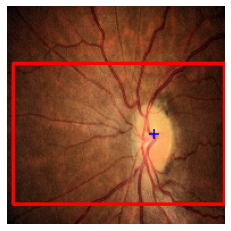

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


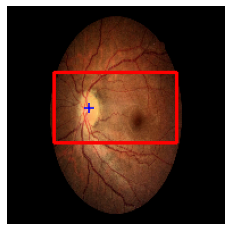

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


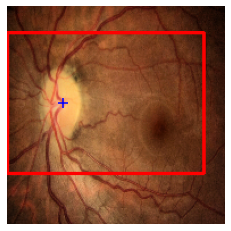

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


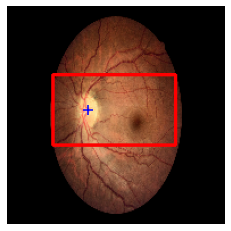

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


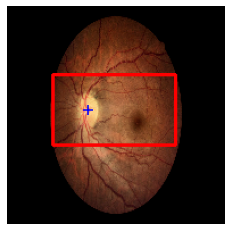

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


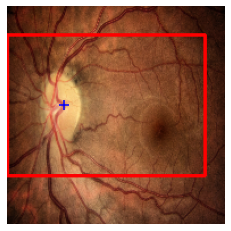

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


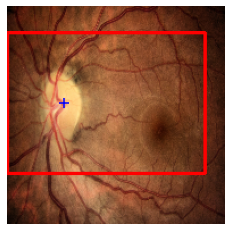

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


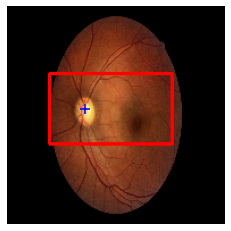

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


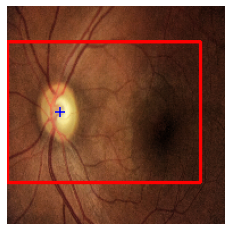

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


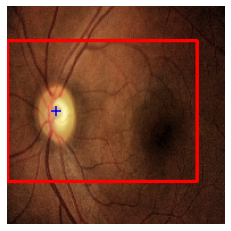

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


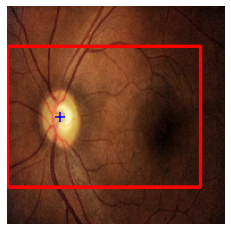

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


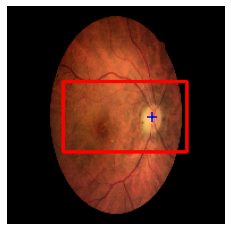

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


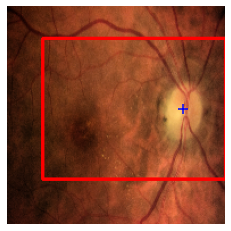

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


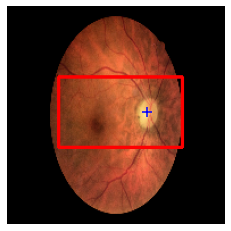

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


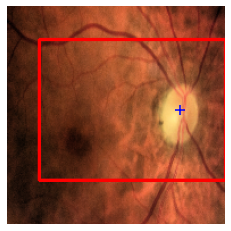

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


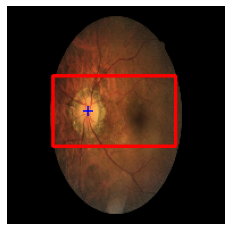

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


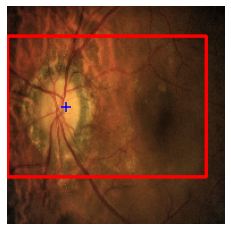

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


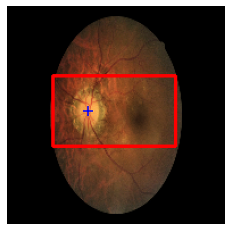

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


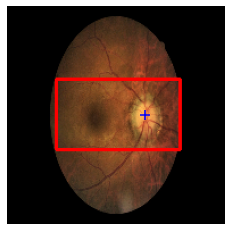

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


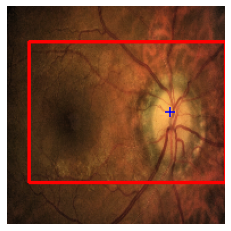

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


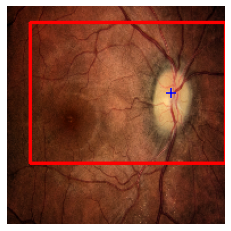

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


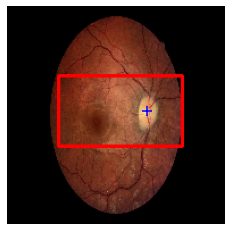

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


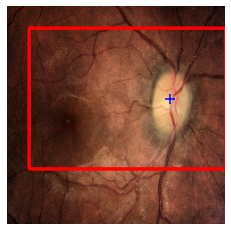

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


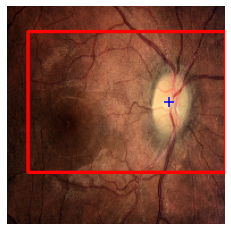

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


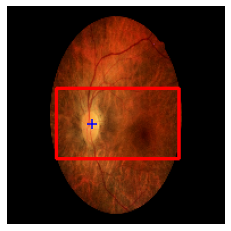

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


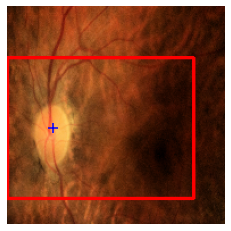

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


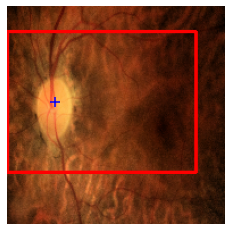

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


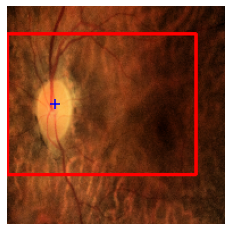

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


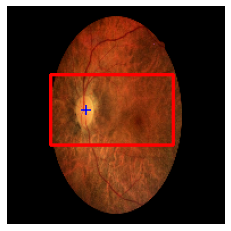

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


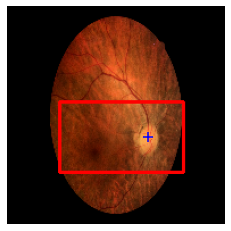

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


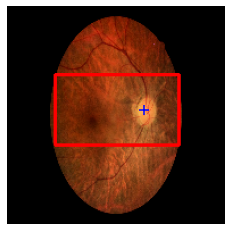

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


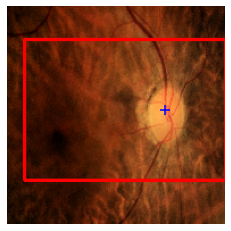

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


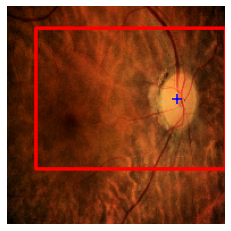

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


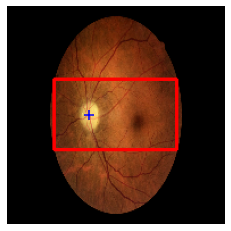

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


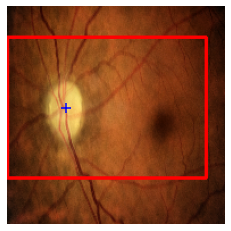

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


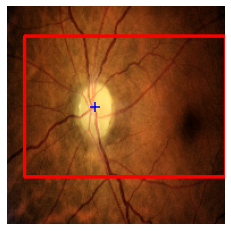

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


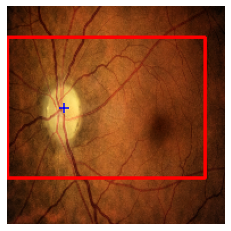

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


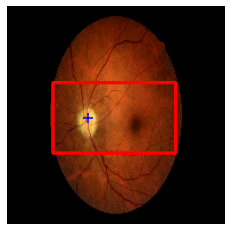

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


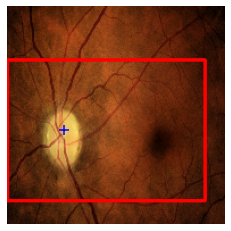

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


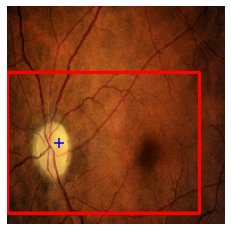

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


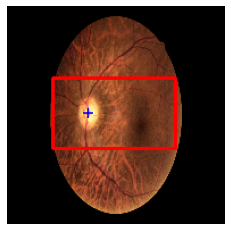

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


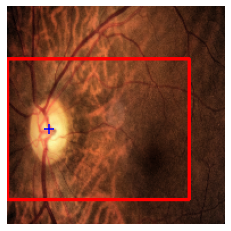

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


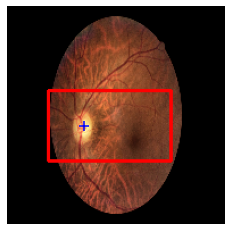

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


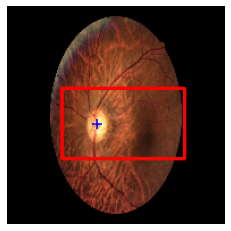

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


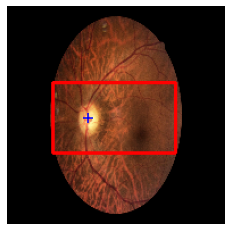

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


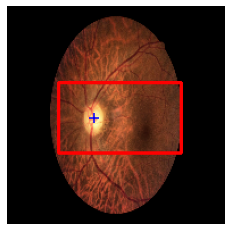

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


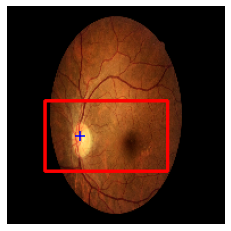

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


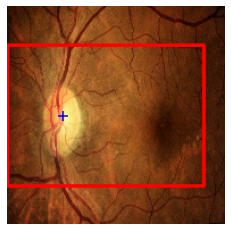

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


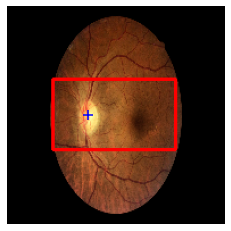

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


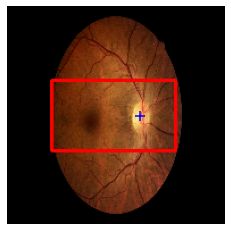

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


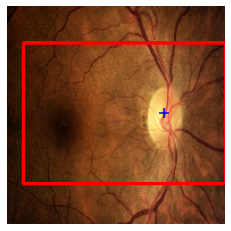

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


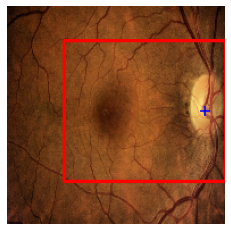

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


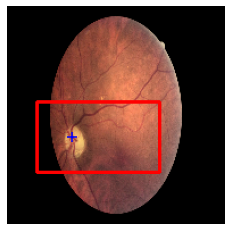

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


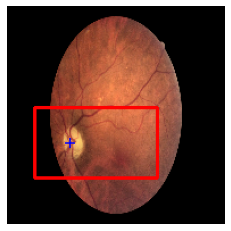

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


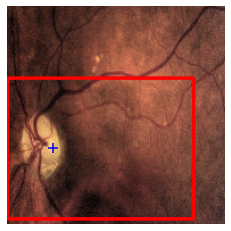

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


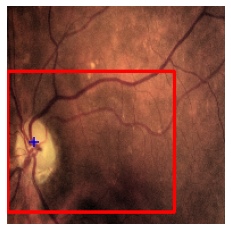

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


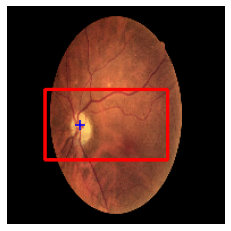

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


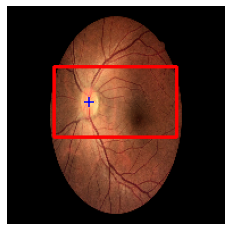

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


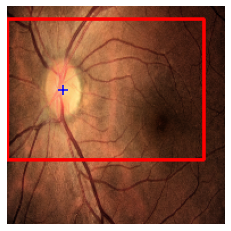

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


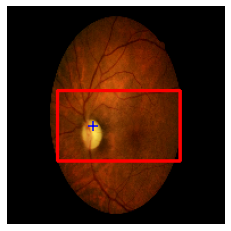

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


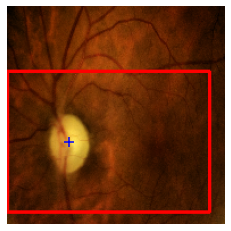

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


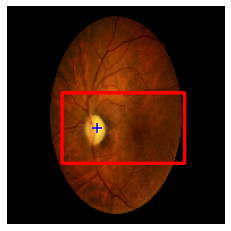

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


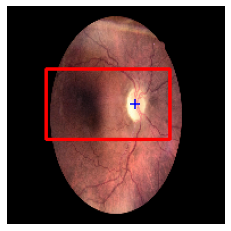

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


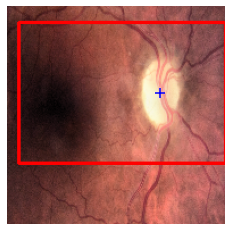

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


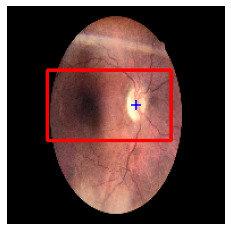

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


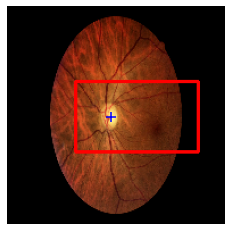

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


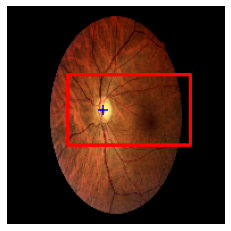

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


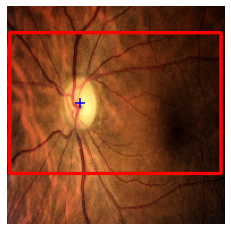

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


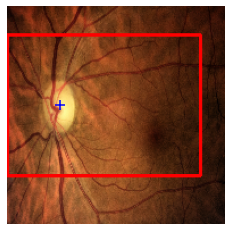

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


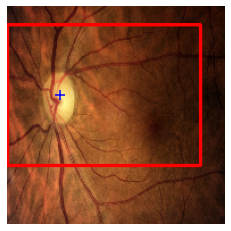

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


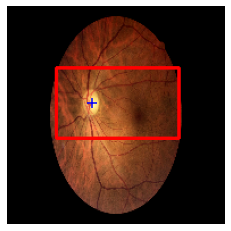

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


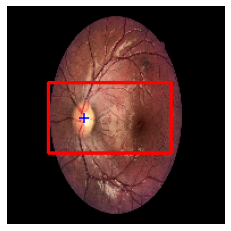

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


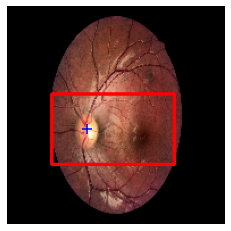

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


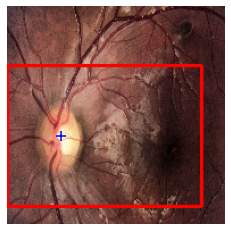

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


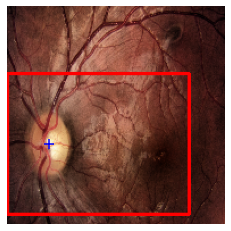

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


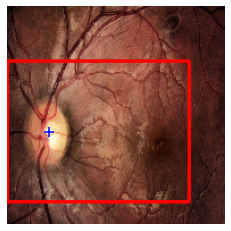

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


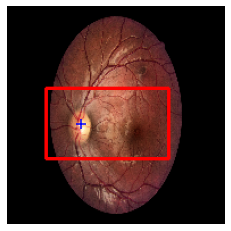

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


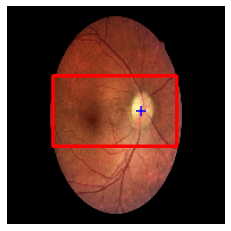

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


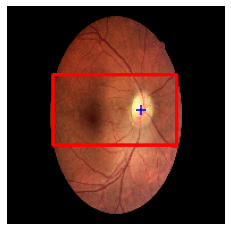

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


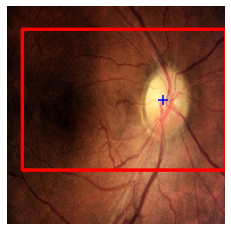

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


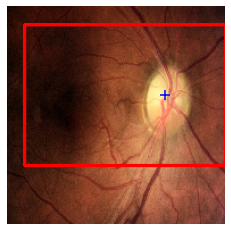

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


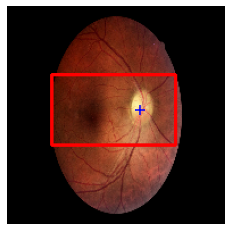

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


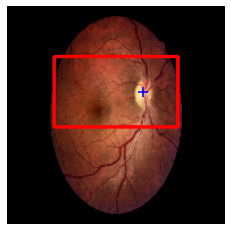

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


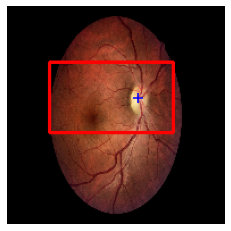

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


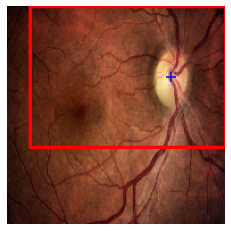

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


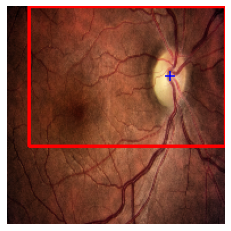

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


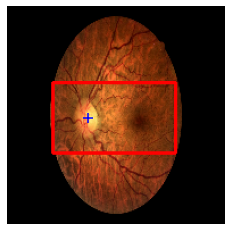

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


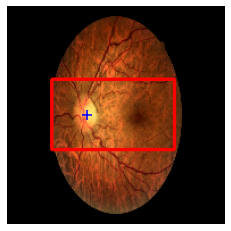

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


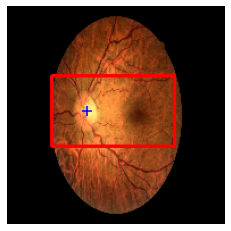

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


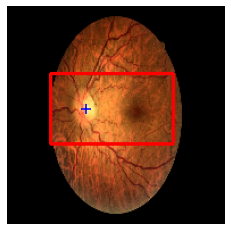

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


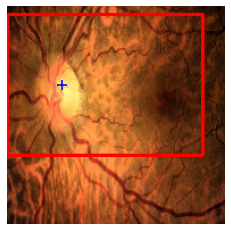

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


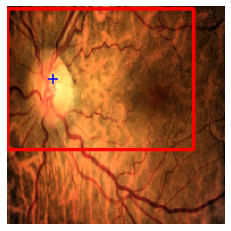

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


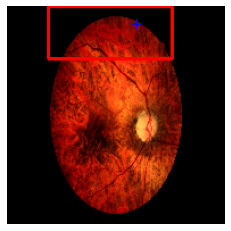

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


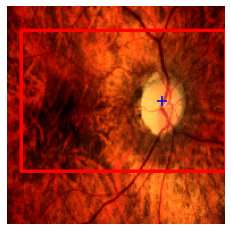

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


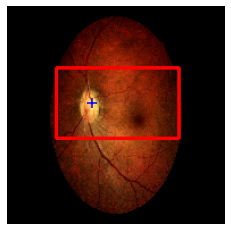

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


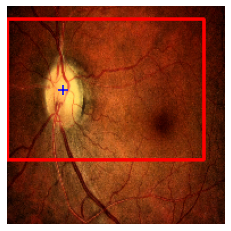

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


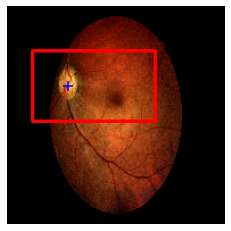

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


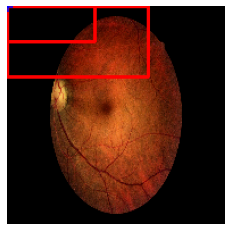

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


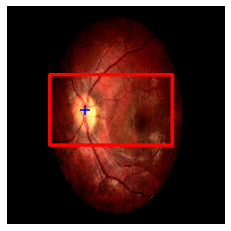

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


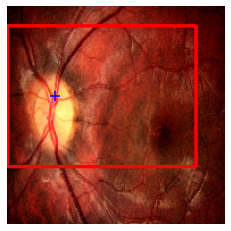

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


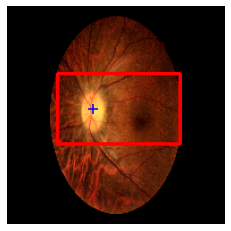

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


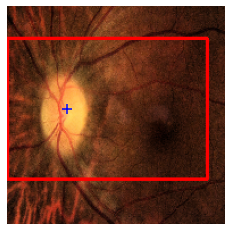

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


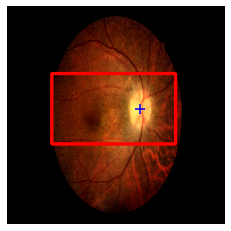

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


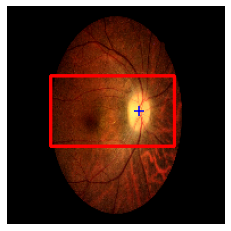

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


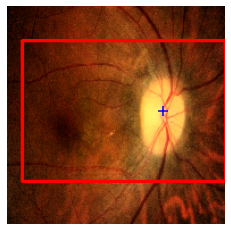

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


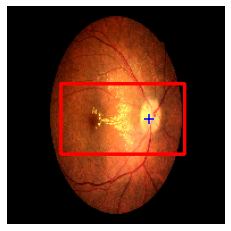

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


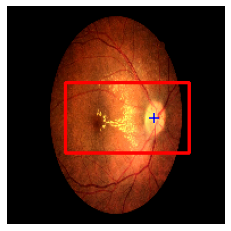

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


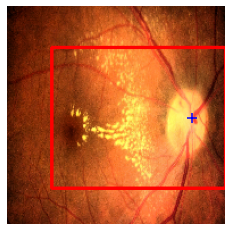

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


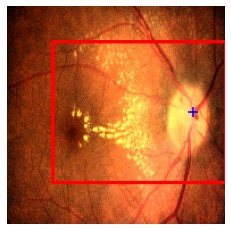

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


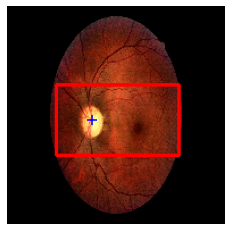

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


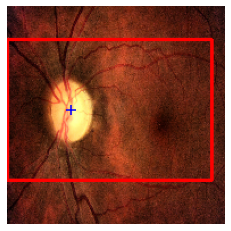

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


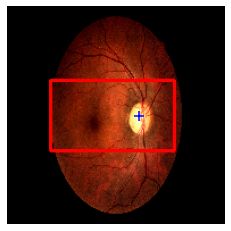

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


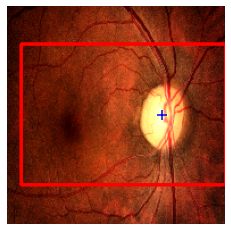

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


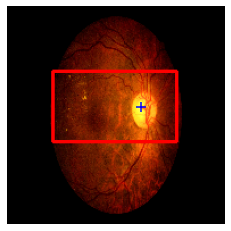

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


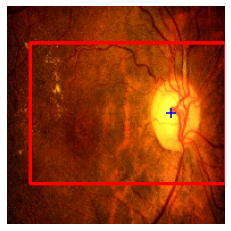

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


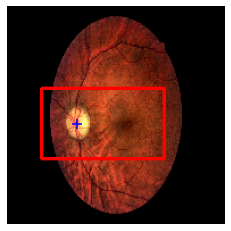

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


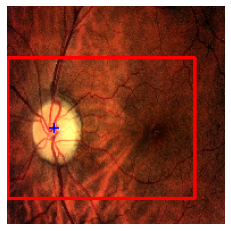

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


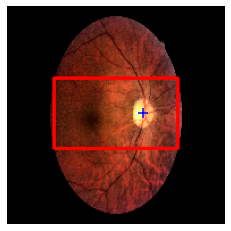

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


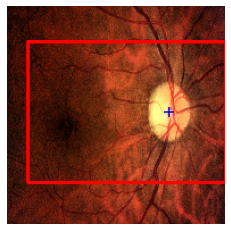

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


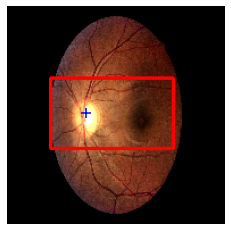

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


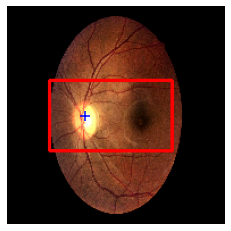

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


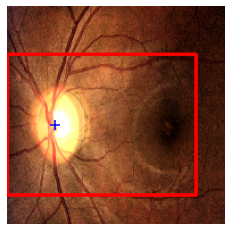

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


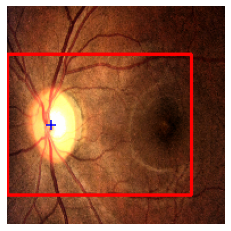

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


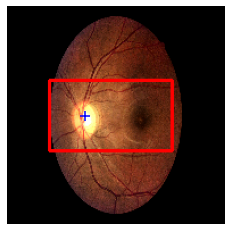

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


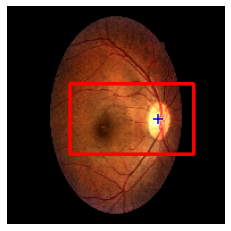

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


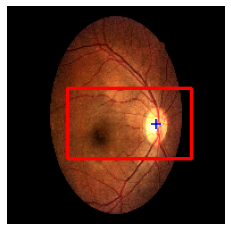

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


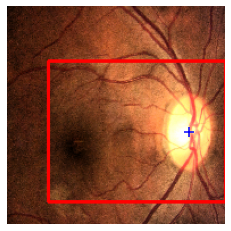

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


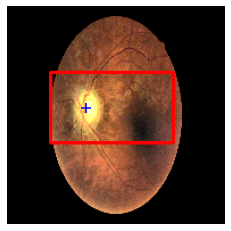

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


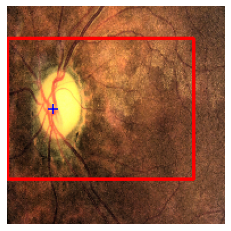

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


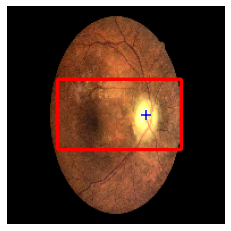

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


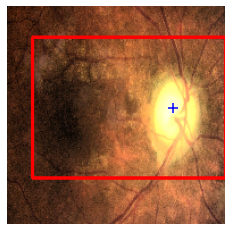

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


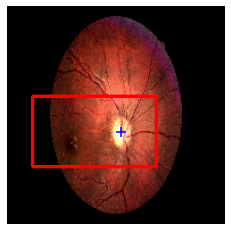

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


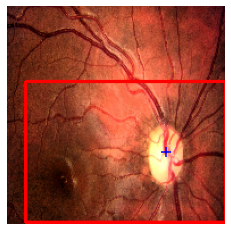

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


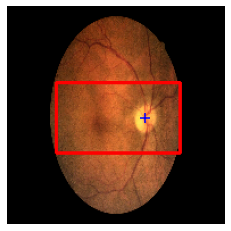

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


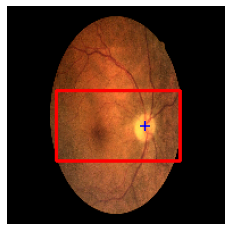

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


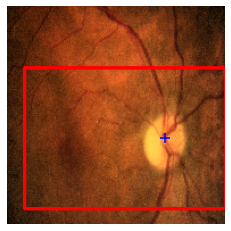

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


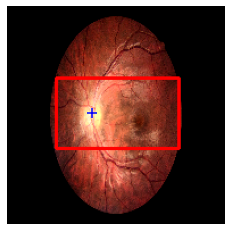

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


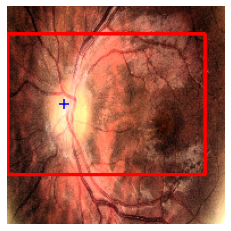

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


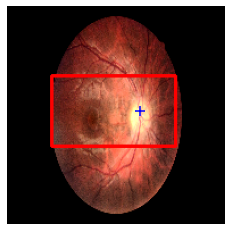

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


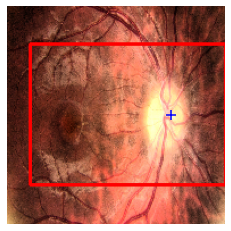

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


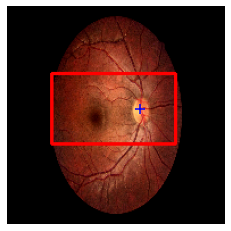

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


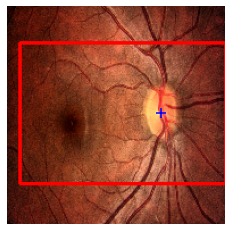

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


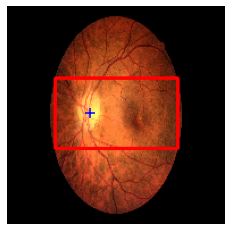

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


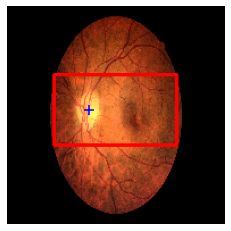

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


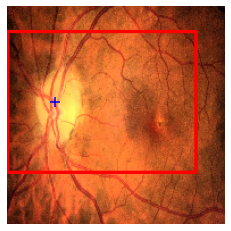

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


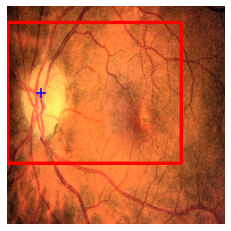

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


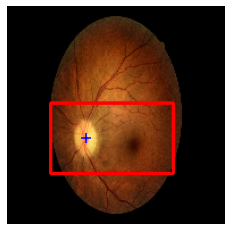

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


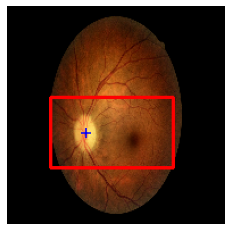

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


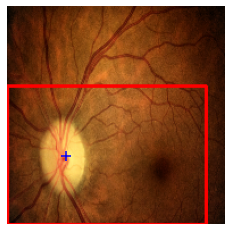

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


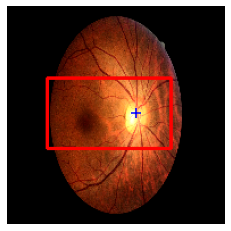

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


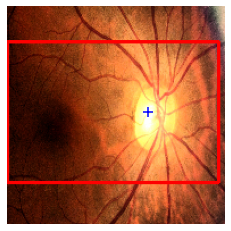

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


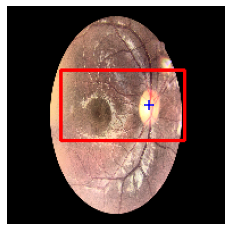

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


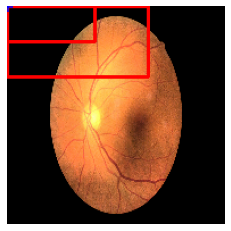

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


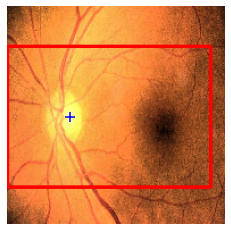

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


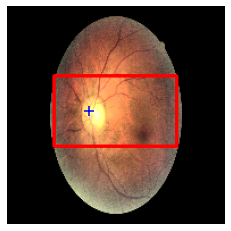

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


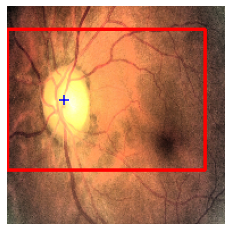

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


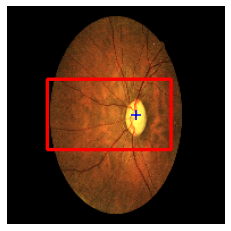

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


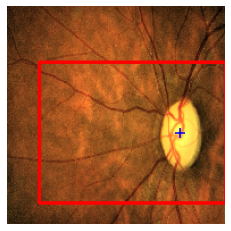

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


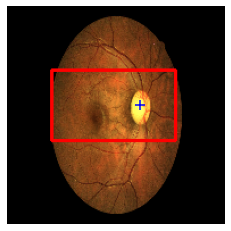

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


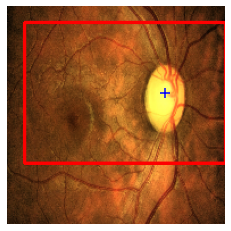

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


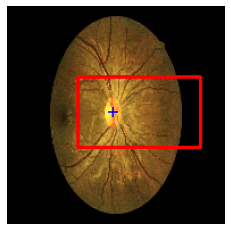

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


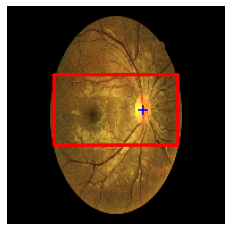

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


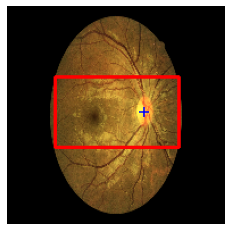

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


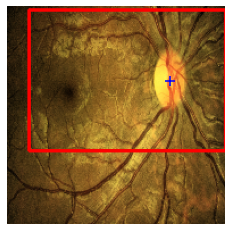

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


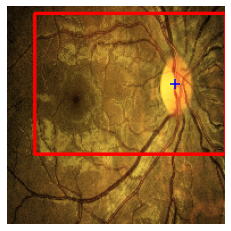

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


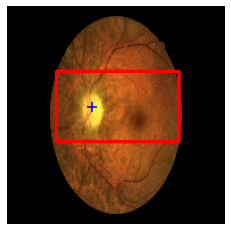

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


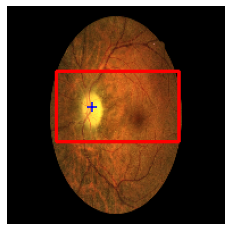

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


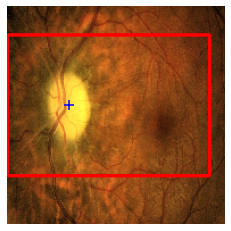

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


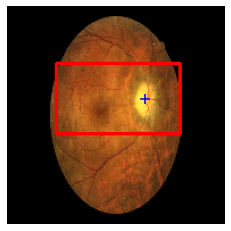

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


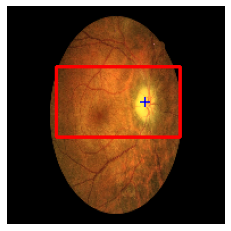

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


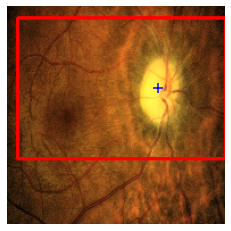

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


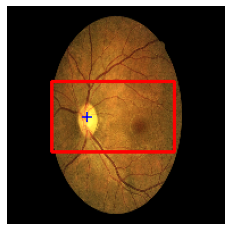

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


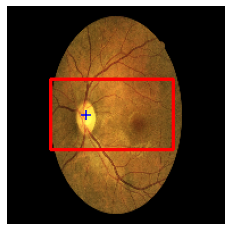

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


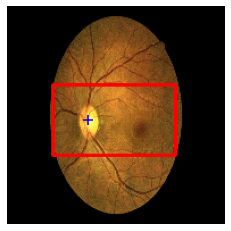

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


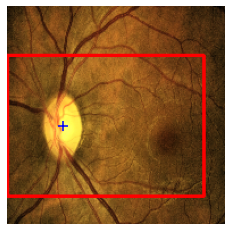

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


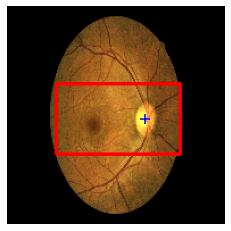

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


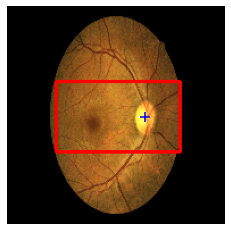

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


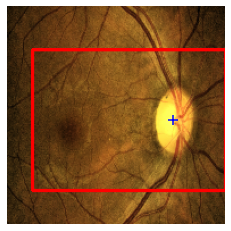

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


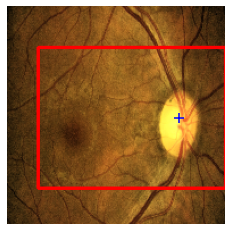

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


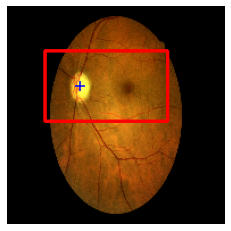

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


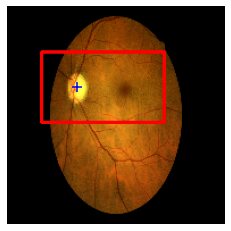

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


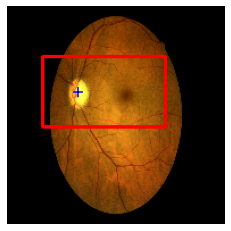

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


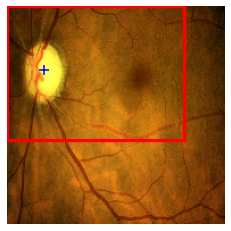

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


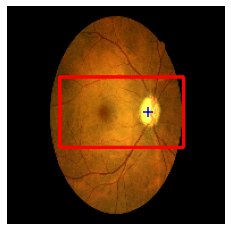

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


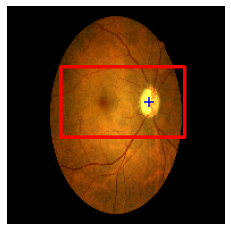

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


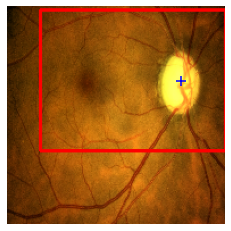

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


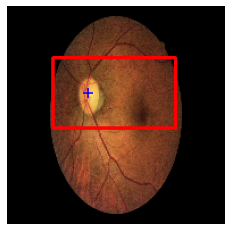

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


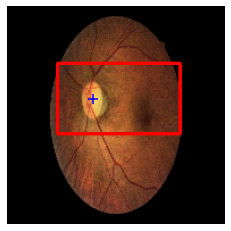

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


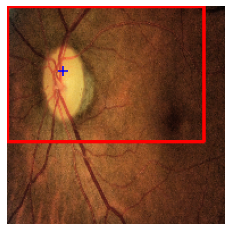

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


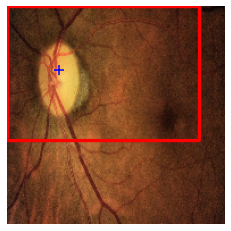

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


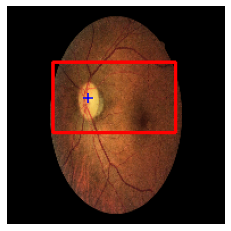

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


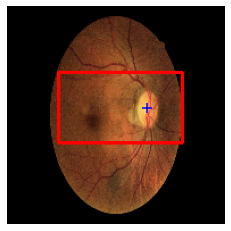

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


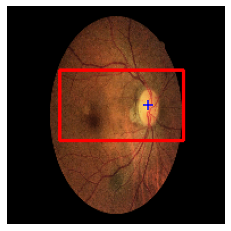

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


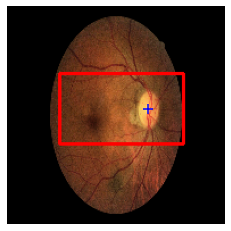

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


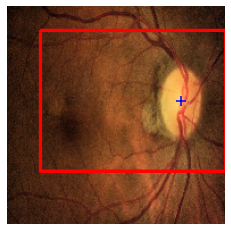

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


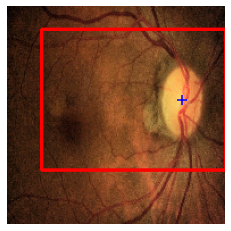

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


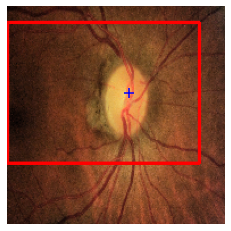

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


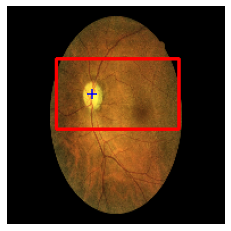

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


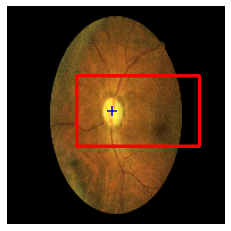

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


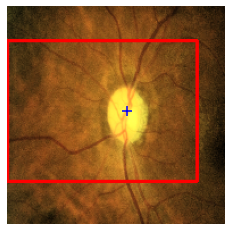

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


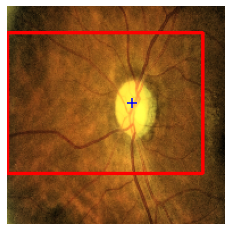

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


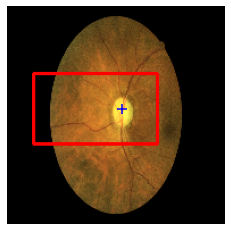

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


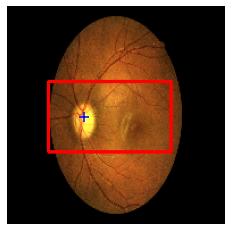

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


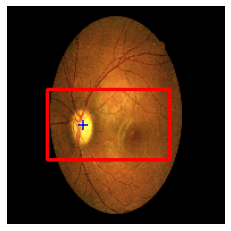

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


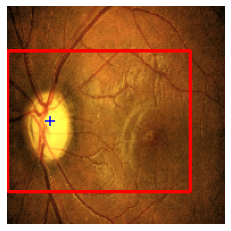

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


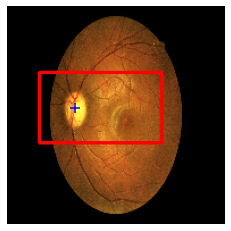

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


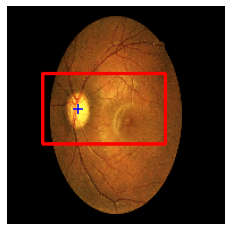

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


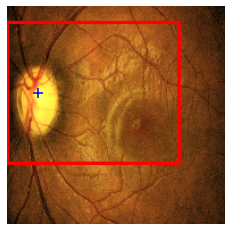

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


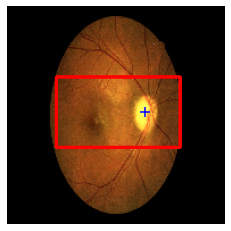

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


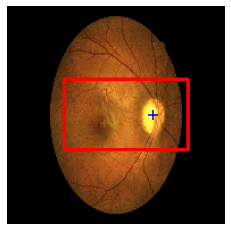

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


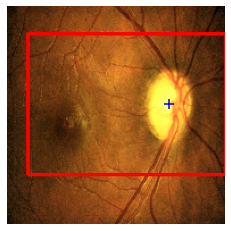

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


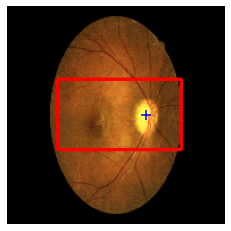

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


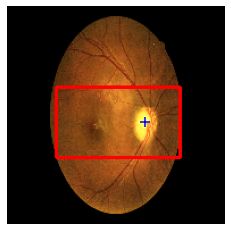

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


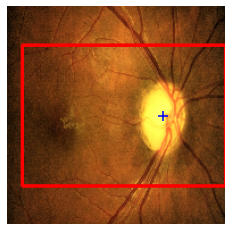

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


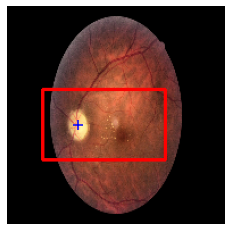

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


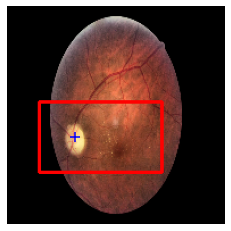

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


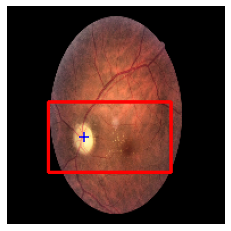

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


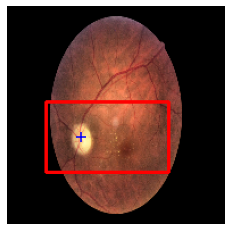

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


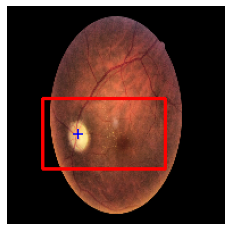

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


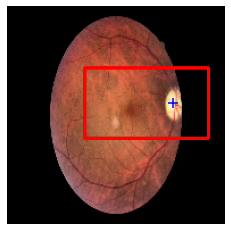

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


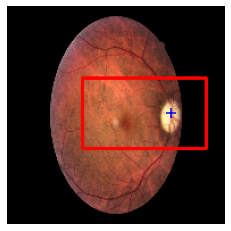

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


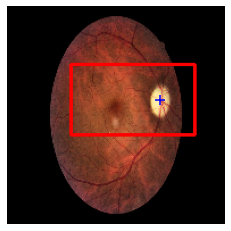

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


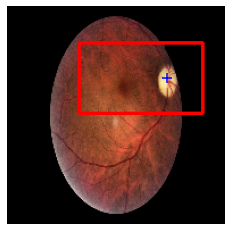

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


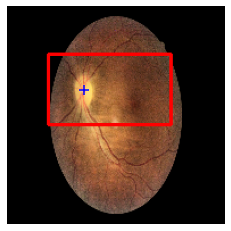

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


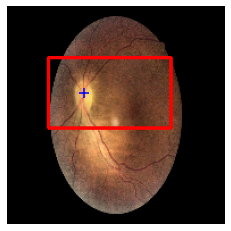

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


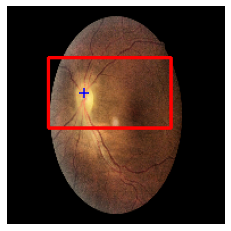

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


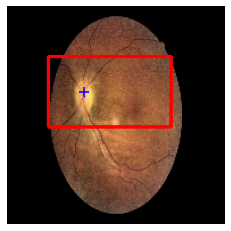

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


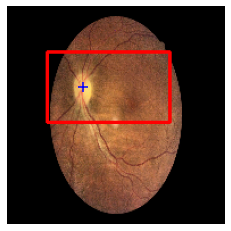

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


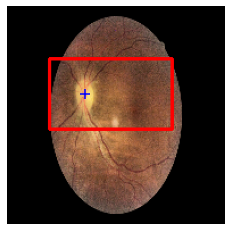

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


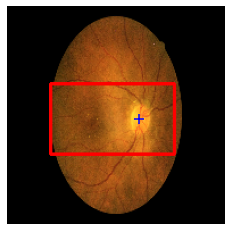

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


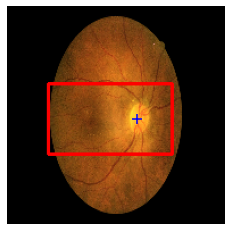

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


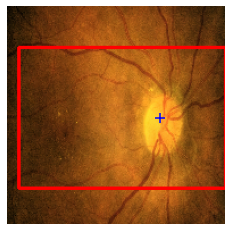

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


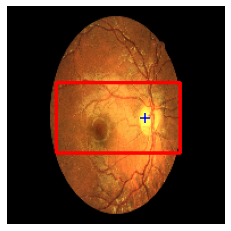

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


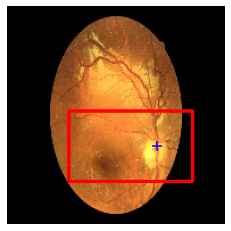

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


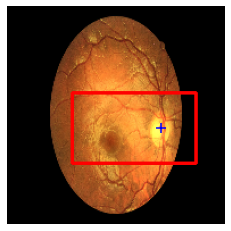

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


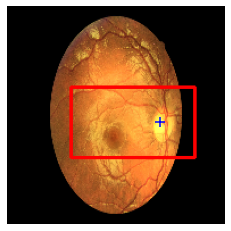

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


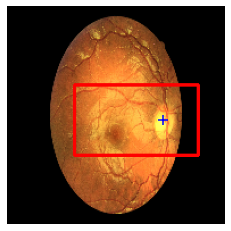

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


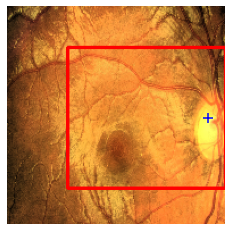

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


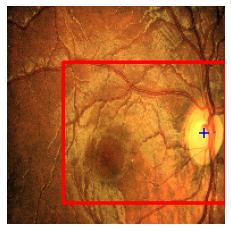

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


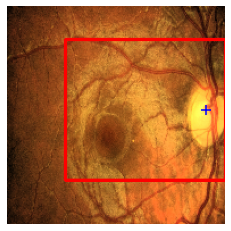

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


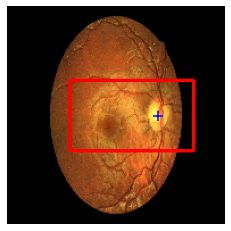

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


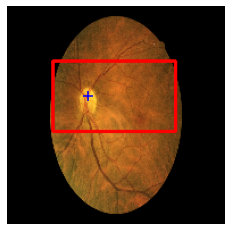

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


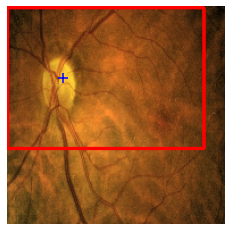

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


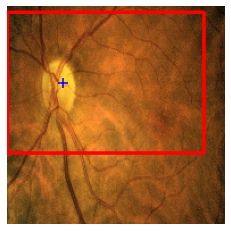

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


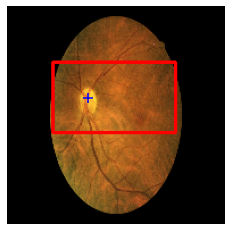

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


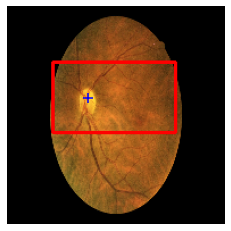

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


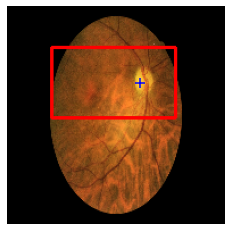

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


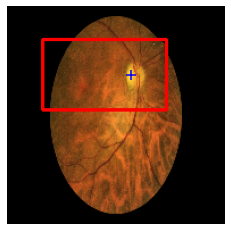

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


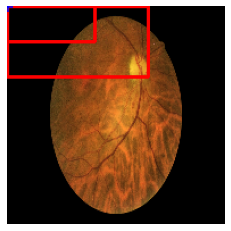

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


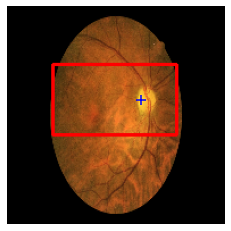

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


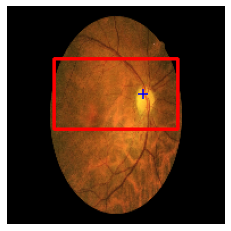

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


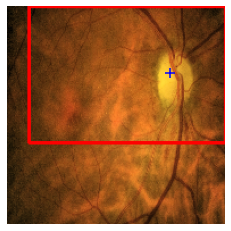

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


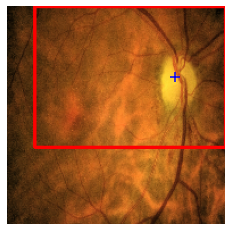

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


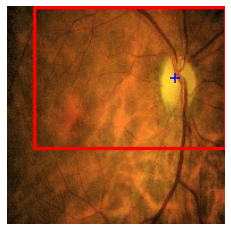

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


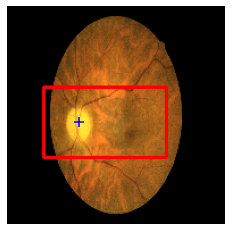

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


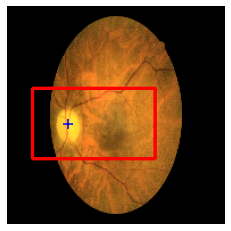

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


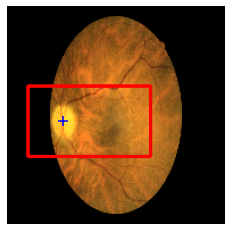

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


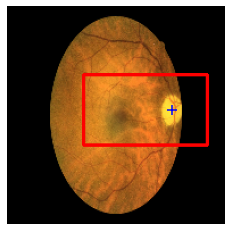

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


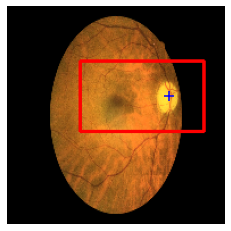

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


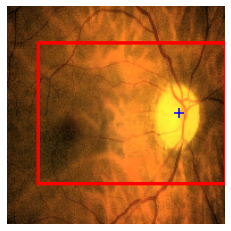

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


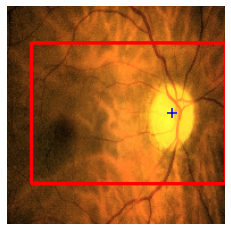

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


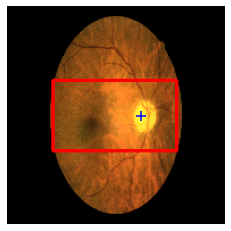

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


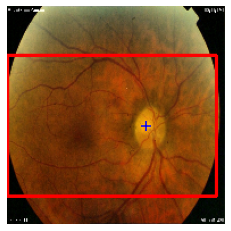

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


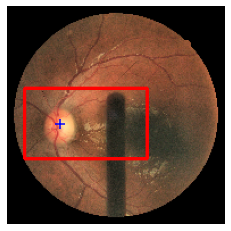

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


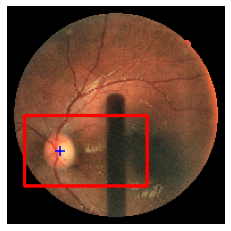

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


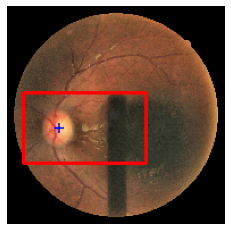

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


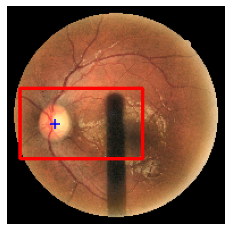

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


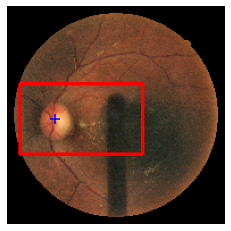

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


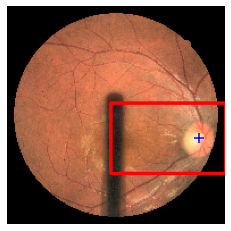

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


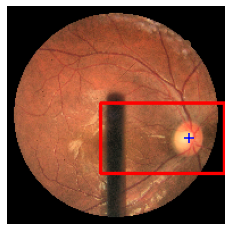

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


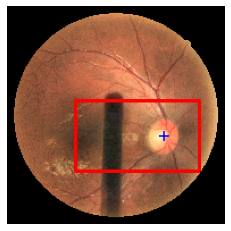

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


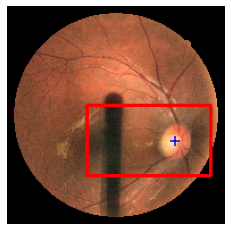

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


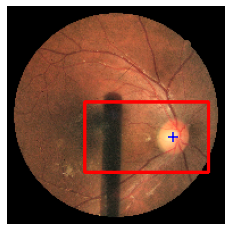

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


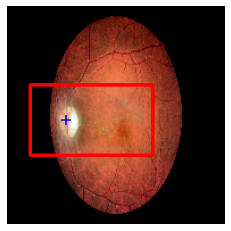

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


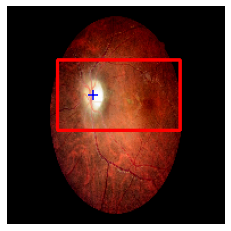

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


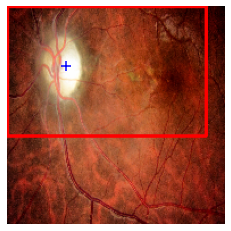

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


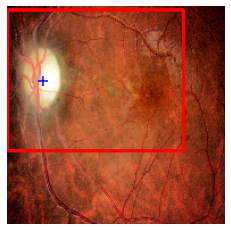

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


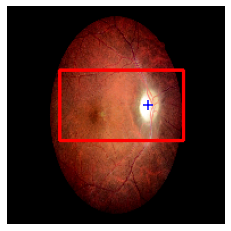

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


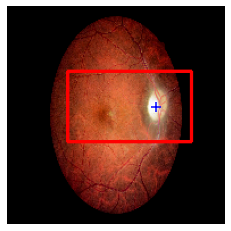

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


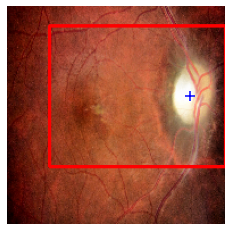

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


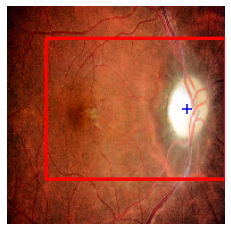

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


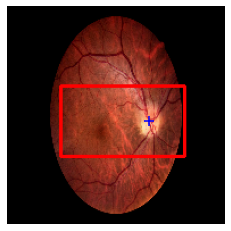

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


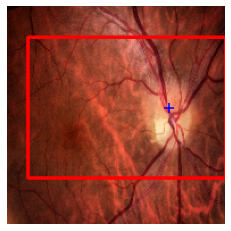

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


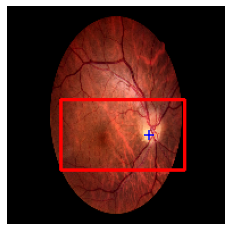

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


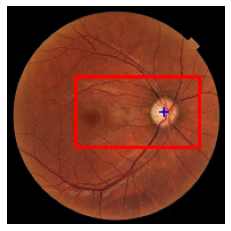

In [ ]:
for i in range(0,len(x1)):
  if np.mean(x1[i,0:20,0:20,:])< 0.009:
    X1 = position1[i,0]-((H))
    Y1 = position1[i,1]-((H))
    X2 = position1[i,0]+((H))
    Y2 = position1[i,1]+((H))
    X1 = np.clip(X1,0,192)
    X2 = np.clip(X2,0,192)
    Y1 = np.clip(Y1,0,192)
    Y2 = np.clip(Y2,0,192)

    if position1[i,0]>=192/2:
      X1 = position1[i,0]-((H))*2
      X1 = np.clip(X1,0,192)
    else:
      X2 = position1[i,0]+((H))*2
      X2 = np.clip(X2,0,192)

  else:
    X1 = position1[i,0]-((H*2))
    Y1 = position1[i,1]-((H*2))
    X2 = position1[i,0]+((H*2))
    Y2 = position1[i,1]+((H*2))
    X1 = np.clip(X1,0,192)
    X2 = np.clip(X2,0,192)
    Y1 = np.clip(Y1,0,192)
    Y2 = np.clip(Y2,0,192)

    
    if position1[i,0]>=192/2:
      X1 = position1[i,0]-((H*2))*1.8
      X1 = np.clip(X1,0,192)
      
    else:
      X2 = position1[i,0]+((H*2))*1.8
      X2 = np.clip(X2,0,192)
    
  f , ax = plt.subplots()
  ax.imshow(x1[i,:,:,:])
  ax.scatter(position1[i,0] , position1[i,1] , c='blue',s=100 , marker='+')
  X1,X2,Y1,Y2 = int(X1),int(X2),int(Y1),int(Y2) 
  #plt.scatter(X1, Y1, c='red',s=50 , marker='*')
  #plt.scatter(X2, Y2, c='red',s=50 , marker='*')
  cv2.rectangle(x1[i,:,:,:], (X1, Y1), (X2, Y2),[255,0,0], 2)
  ax.axis('off')
  f.savefig(f'{folder_name3}/{name1[i]}')
  plt.show()
  